# Fish Recognition

### Introduction

ABSTRACT:

Nearly half of the world depends on seafood for their main source of protein. In the Western and Central Pacific, where 60% of the world’s tuna is caught, illegal, unreported, and unregulated fishing practices are threatening marine ecosystems, global seafood supplies and local livelihoods. The Nature Conservancy is working with local, regional and global partners to preserve this fishery for the future.
For that reason, The Nature Conservancy has developed and deployed electronic cameras on fishing boats, specifically for monitoring purposes. The amount of raw data produced is cumbersome to process manually.

Using Machine Learning algorithms to detect and classify the species of fish, which are caught by the camera, can possibly help automate the reviewing process and could contribute to preserving the fisheries in the future.

### Problem statement

We are required to detect which species of fish appears on a fishing boat, based on images captured from boat cameras of various angles. 
Goal:
 - __Detect and/or classify the species of fish that are captured by the monitoring cameras__

To try and solve this problem, we will explore the provided frames, and attempt to create and improve several __Convolutional Neural Networks__ and possibly use other popular image detection architectures. 

### Dataset


 - The Nature Conservancy Fisheries Monitoring dataset - https://www.kaggle.com/c/the-nature-conservancy-fisheries-monitoring/data
 
The images are captured from boat cameras from various angles and each image has only one fish category. 

__Eight__ categories of fish are present: 

__Albacore tuna, Bigeye tuna, Yellowfin tuna, Mahi Mahi, Opah, Sharks, No Fish, Other__. The dataset is comprised only of raw images.![species-ref-key.jpg](species-ref-key.jpg)

### Libraries

- __pandas__ - filtering the class information
- __matplotlib__ - Exploratory Data Analysis on the dataset and image plotting
- __numpy__ - for image transformation and manipulation, condition-based filtering
- __os__ - file directory traversal and loading
- __scikit-image__ - main image preprocessing algorithms
- __scikit-learn__ - for data preprocessing and model evaluation
- __imblearn__ - dealing with imbalanced data - Oversampling
- __tensorflow (keras)__ - model creation and optimization, image preprocessing - data augmentation

### Project structure

1. Exploring the images and class distributions.
2. Creating the model features and labels.
3. Preprocessing the data - encoding the labels, splitting and balancing the dataset.
4. Creating and evaluating a __baseline CNN model__.
5. Creating and evaluating a __deeper CNN model__ based on the last one.
6. Applying transfer learning using __VGG19__ to classify the species.

We begin by loading the needed libraries and modules.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import random
import os
import json
import ast

from imblearn.over_sampling import RandomOverSampler

from skimage.io import imread, imsave
import joblib
from joblib import dump, load
from skimage.transform import resize, rotate, rescale
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.layers import Dense, Dropout, GaussianNoise, BatchNormalization, Conv2D, MaxPool2D, Flatten, Input, Activation, Add
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import RMSprop, Adam
from tensorflow.keras import backend as K
from tensorflow.keras.applications import VGG19


### 1. Exploring the images and class distributions.

We'll begin by defining some important variables, which will be used throughout the project - the directory that contains the images, the known classes and the image dimensions.

Most of the images' shapes are: $1280\times720\times3$. 

For faster training, I will reduce the image height and width, whilst preserving the aspect ratio, dividing them by __4__: $320\times180\times3$.

In [2]:
input_dir = "fish_data/train/train/"
fish_classes = ['ALB', 'BET', 'DOL', 'LAG', 'NoF', 'OTHER', 'SHARK', 'YFT']
img_w = 180
img_h = 320
num_channels = 3

A small helper-function to read and resize an image by the specified height and width.

In [3]:
def read_image(src):
    img = imread(src)
    img_resized = resize(img, (img_w, img_h))
    return img_resized 

This function will help us to load all the image file names in a list and see the amount of images in each class. 

In [4]:
def get_labels_and_class_distributions(directory):
    filenames = []
    class_lengths = []
    for fish in fish_classes:
        
        # getting in directory for every fish class 
        fish_dir = directory + '{}'.format(fish)
        
        # getting filename for images in each class and adding it to the filenames list
        images = [fish + '/' + im for im in os.listdir(fish_dir)]
        filenames.extend(images)
        
        # printing filename ie., images in each class
        print("{0} photos of {1}".format(len(images), fish)) 
        
        # count of images of particular class
        class_lengths.append(len(images))
        
    # plotting histogram 
    
    plt.bar(range(len(class_lengths)), class_lengths)
    plt.xticks(range(len(fish_classes)), fish_classes)
    plt.title('Class distribution for fishes')
    plt.xlabel('Class Name')
    plt.ylabel('Count')
    plt.show()
    return filenames

Lets also plot a histogram for a clearer view of the class distributions.

1719 photos of ALB
200 photos of BET
117 photos of DOL
67 photos of LAG
465 photos of NoF
299 photos of OTHER
176 photos of SHARK
734 photos of YFT


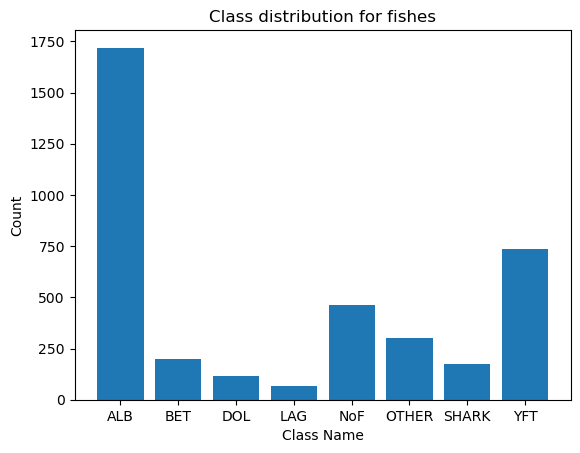

In [5]:
fish_filenames = get_labels_and_class_distributions(input_dir)

In [6]:
print(len(fish_filenames))

3777


From what we can see, there aren't a lot of images - only __3777__ samples and the data is highly imbalanced - one class persists in around __half__ of the samples. We will try to solve this issue later on.

For now, we can visualize what the images look like by plotting a few random samples, along with the class they belong to.

In [7]:
def plot_images(directory, examples=10): 
    for i in range(examples):
        
        # getting class index
        rnd_idx_cl = np.random.randint(0, len(fish_classes))
        
        # according to that index getting corresponding class
        rnd_class = fish_classes[rnd_idx_cl]
        
        # according to class getting particular image index
        rnd_idx = np.random.randint(0, len(os.listdir(directory + '/' + rnd_class)))
        
        # getting filename of that particular image 
        filename = os.listdir(directory + '/' + rnd_class)[rnd_idx]
        
        # reads and load that image
        img = imread(os.path.join(directory + '/' + rnd_class, filename))
        
        # plotting images 
        plt.title(rnd_class)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

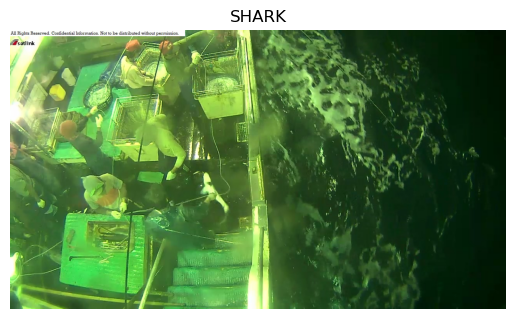

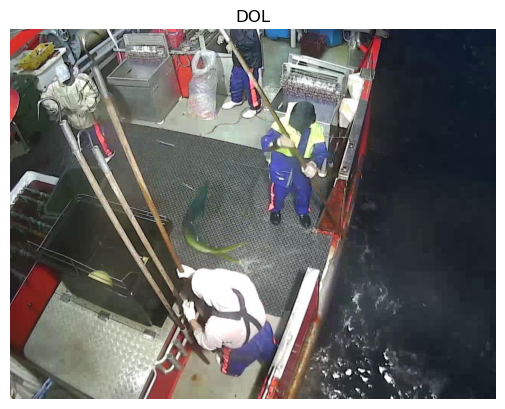

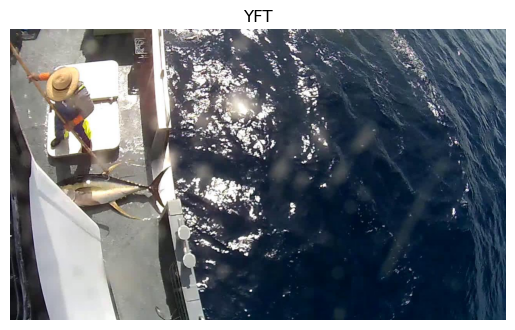

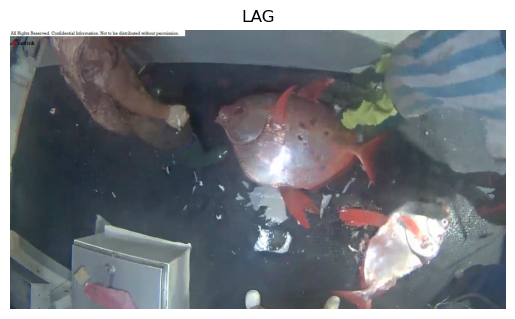

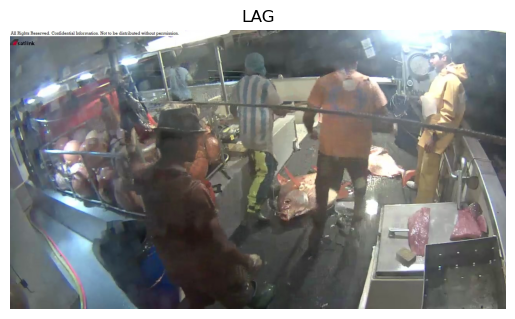

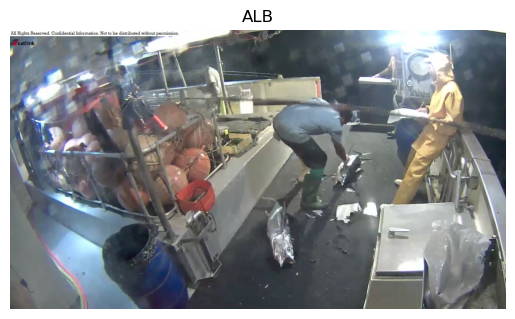

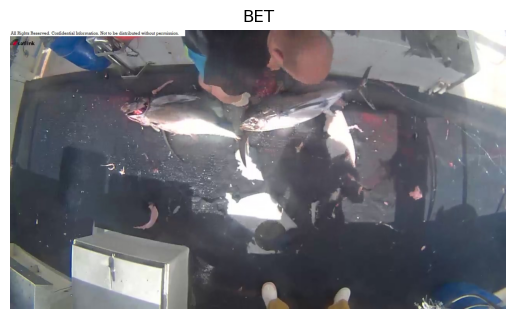

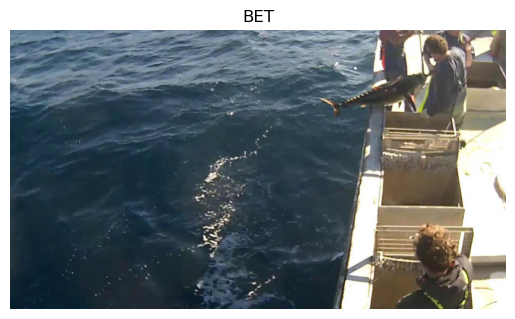

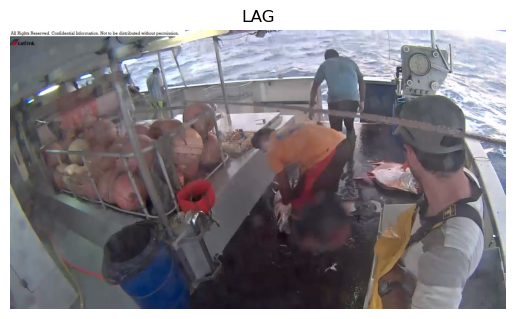

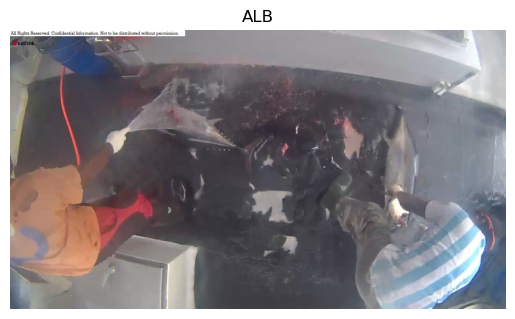

In [8]:
plot_images(directory=input_dir)

We can see that the images are taken at different times of day - the nighttime images might be confusing for the model, because of the drastic change in color. There are also samples, where only parts of a fish is shown and images that contain mostly a view of the ocean seem to have no fishes.

### 2. Creating the model features and labels.



Next, let's make a helper-function for loading and saving the image features and labels to disk and to a numpy array. We will traverse each class directory, similar to before, read and resize each image, and add a new value to the features and labels list. After the process is done, we'll save the data to disk using __joblib__ and return the values as numpy arrays. 

If the model has already been loaded, we'll simply use __joblib's__ load function.

In [9]:
def load_features(directory, img_w, img_h, loaded=False, features_file = 'fish_features.jbl', 
                  labels_file = 'fish_labels.jbl'):
    
    features = []
    labels = []
    
    if loaded:
        
        print('Loading saved dataset..')
        
        if os.path.isfile(features_file):
            features = joblib.load(features_file)
            
        if os.path.isfile(labels_file):
            labels = joblib.load(labels_file)
            
        print('Done')
        
        return np.array(features), np.array(labels)
    
    for fish in fish_classes:
        
        # getting filenames/images for every class and storing it in class_folder list
        class_folder = os.listdir(directory + '/' + fish)
        
        # construct fullpath to current fish class
        class_folder_name = os.path.join(directory + '/' + fish)
        
        # variable to keep track of progress within the loop
        step = 0
        
        for filename in class_folder:
            
            if step % 100 == 0:
                print(('Processed {:.2f}% of {} images').format((step/len(class_folder)) * 100, fish))
                
            # read and load particular image from current folder/class
            img = imread(os.path.join(class_folder_name, filename))
            
            # resizing image and adding to features list
            img_resized = resize(img, (img_w, img_h))
            
            features.append(img_resized)
            
            # adding corresponding class name of image to lebels list
            labels.append(fish)
            
            step = step + 1

    print('Done')
    
    # if data is not loaded from disk then save it to disk
    if loaded == False:
        print('Saving dataset to disk..')
        #joblib.dump(features, features_file)
        #joblib.dump(labels, labels_file)
        
    return np.array(features), np.array(labels)

In [10]:
#fish_features, fish_labels = load_features(input_dir, img_w=img_w, img_h=img_h)

Confirm the shapes after loading..

In [11]:
fish_features, fish_labels = load_features(input_dir, img_w=img_w, img_h=img_h, loaded=True)

Loading saved dataset..
Done


In [12]:
print(fish_features.shape, fish_labels.shape)

(3777, 180, 320, 3) (3777,)


Now let's plot a few features to confirm that they're still in good quality. Using this helper-function we can either plot __3 random features__ or __the first 3 images from a specific starting point__. 

In [13]:
def plot_loaded_features(feature, num_cols=3, num_rows=1, random=1, first_idx=0, custom_label=False, 
                         test_errors=None, test_error_labels=None, test_truth=None):
    
    f, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(15,4))
    
    idx = first_idx
    
    for i in range(num_cols):
        
        if random:
            idx = np.random.randint(0, len(feature))
            plt.suptitle('Random fish features')
        
        else:
            plt.suptitle('First 3 fish features from start: {}'.format(first_idx))
        
        ax[i].grid(False)
        ax[i].get_xaxis().set_visible(False)
        ax[i].get_yaxis().set_visible(False)
        
        if custom_label:
            idx = np.random.randint(0, len(test_errors))
            test_label = np.argmax(test_truth, axis=1)
            ax[i].set_title('Predicted: {}, True:{}'.format(fish_classes[test_error_labels[idx]], 
                                                            fish_classes[test_label[idx]]))
        
        ax[i].imshow(feature[idx])
        idx += 1
        
    plt.tight_layout()
    plt.show()

def plot_single(feature, random=1): 
    
    plt.grid(False)
    
    plt.imshow(feature.reshape(img_w, img_h, num_channels),
               interpolation='nearest',
               cmap='binary')
    
    plt.show()

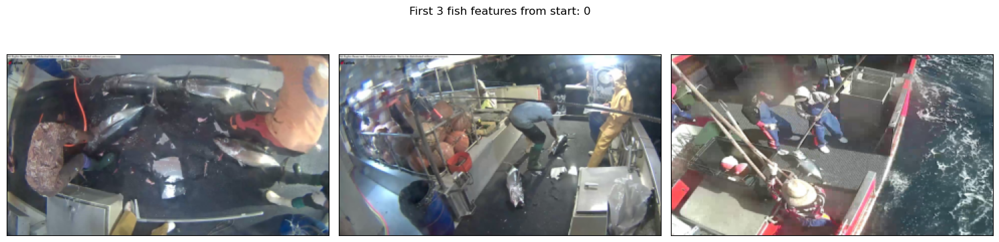

In [14]:
plot_loaded_features(fish_features, random=0)

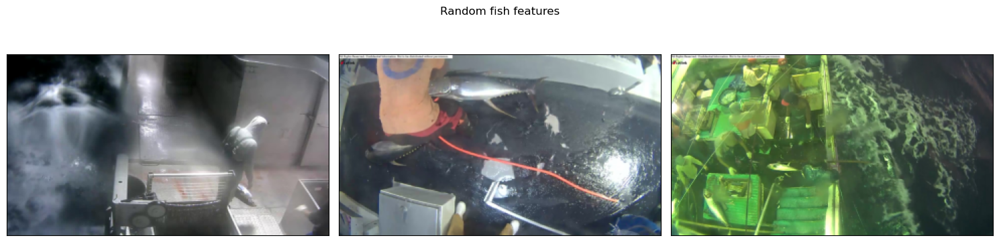

In [15]:
plot_loaded_features(fish_features, random=1)

The images seem to be in good shape, so we can move on to the next step.

### 3. Preprocessing the data - encoding the labels, splitting and balancing the dataset.

First, we can simplify the computations a little bit by converting the fish features data format to _32 bits_.

In [16]:
fish_features.dtype

dtype('float64')

In [17]:
fish_features = fish_features.astype(np.float32)

Now let's split the dataset into a training, validation and test set.

First, we'll do a _90% training / 10% validation_ split. Even though we don't have a lot of data right now, after we balance the classes and generate more samples, the training amount is expected to rise a lot, so it still should be a good idea for achieving stable results.

After that, we'll hold out a few of the training examples for testing and the final distribution will be: __88% training / 10% validation / 2% test__. The validation set will be the main factor for evaluation and the test data will be just for predicting new data that the model has not yet seen, for additional confirmation.

In [18]:
fish_train_features, fish_val_features, fish_train_labels, fish_val_labels = train_test_split(fish_features, fish_labels, test_size=0.1, 
                                                                                              random_state=42,
                                                                                             stratify=fish_labels)

In [19]:
fish_train_features, fish_test_features, fish_train_labels, fish_test_labels = train_test_split(fish_train_features, fish_train_labels, test_size=0.02, 
                                                                                                random_state=42,
                                                                                               stratify=fish_train_labels)

In [20]:
print("Train features:{}, Validation features:{}, Test features:{}".format(fish_train_features.shape, fish_val_features.shape,
                                                              fish_test_features.shape))

Train features:(3331, 180, 320, 3), Validation features:(378, 180, 320, 3), Test features:(68, 180, 320, 3)


In [21]:
print("Train labels:{}, Validation labels:{}, Test labels:{}".format(fish_train_labels.shape, fish_val_labels.shape,
                                                              fish_test_labels.shape))

Train labels:(3331,), Validation labels:(378,), Test labels:(68,)


After splitting, we have: $3331$ training, $378$ validation, $68$ test samples.

In [22]:
len(fish_train_features)

3331

This amount of data is very insufficient for neural networks. 

What we can do to combat this is __Oversampling__. This technique will help us increase the amount of data, whilst simultaneously __balancing__ the data for each class by repeatedly sampling the same images (this helps us make use of the accuracy metric), until they amount to the class with the highest samples - __ALB (1516)__. This will also increase the bias in the model, making it harder to overfit. In order to apply this method, we are going to reduce the input to __2D__, fit the __OverSampler__, and reshape it back to __4D__. 

We are going to apply this method only to the training set, in order to have a more realistic evaluation of the model performance.

In [23]:
def balance_data(train_features, train_labels):
    
    # reshape fish_train_features into a 2D array. 
    # The -1 in the reshape operation means to maintain the original total number of elements(cols).
    train_features_bal = fish_train_features.reshape(len(fish_train_features), -1)
    
    # creating instace of the RandomOverSampler class
    ros = RandomOverSampler()
    
    # oversampling the training data
    train_features_bal, train_labels_bal = ros.fit_resample(train_features_bal, fish_train_labels)
    
    # reshaping train_features_bal back into its original shape
    train_features_bal = train_features_bal.reshape(len(train_features_bal), img_w, img_h, num_channels)
    
    print("Values after balancing:")
    
    print(pd.value_counts(train_labels_bal))
    
    return train_features_bal, train_labels_bal

In [24]:
fish_train_features_bal, fish_train_labels_bal = balance_data(fish_train_features, fish_train_labels)

Values after balancing:
YFT      1516
OTHER    1516
BET      1516
ALB      1516
SHARK    1516
NoF      1516
DOL      1516
LAG      1516
Name: count, dtype: int64


In [25]:
pd.value_counts(fish_train_labels)

ALB      1516
YFT       648
NoF       410
OTHER     264
BET       176
SHARK     155
DOL       103
LAG        59
Name: count, dtype: int64

Now we can observe the differences in the training set: the sample size is now $1516 \times 8 = 12128$.

In [26]:
fish_train_features_bal.shape

(12128, 180, 320, 3)

In [27]:
fish_train_labels_bal.shape

(12128,)

We did reduce and expand the images in the balancing, so just to make sure, let's confirm again that they're still in good shape.

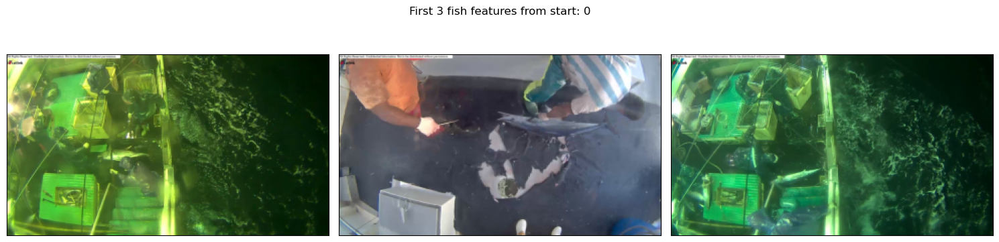

In [28]:
plot_loaded_features(fish_train_features_bal, random=0)

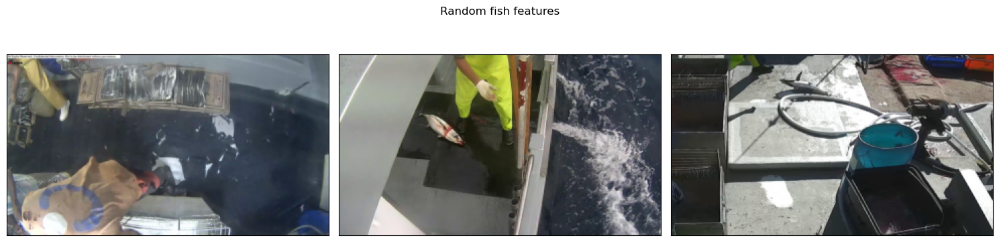

In [29]:
plot_loaded_features(fish_train_features_bal, random=1)

Now, all that's left is to preprocess the labels - encode the classes as integers and categorize them into a matrix.
 
Preprocess the class labels for different datasets (training, balanced training, testing, and validation) by first encoding them as integers and then converting them into one-hot encoded format.

One-hot encoding is commonly used for classification tasks, where each class is represented as a binary vector, with a 1 in the position corresponding to the class and 0s in all other positions.



In one-hot encoding, each category (class) is represented as a binary vector. Each element in the vector corresponds to a class, and only one element is "hot" (set to 1) while all others are "cold" (set to 0). This representation ensures that there's no implied ordinal relationship between the classes.

Neural networks and many machine learning algorithms interpret one-hot encoded labels more effectively because they can treat each class independently without assuming any ordering or numeric relationship between them.

One-hot encoding also helps prevent the model from assuming that there's a natural order or hierarchy among the classes. For example, if you encoded classes as integers (e.g., 0, 1, 2), the model might mistakenly interpret these numbers as having a meaningful relationship (e.g., class 2 is "greater" than class 1). One-hot encoding avoids such misunderstandings.

LabelEncoder() is used to convert categorical labels to unique numerical labels.

to_categorical() is used to convert these numerical labels into one-hot encoded format, ensuring that the machine learning algorithm can work with them effectively.

This two-step process ensures that the labels are represented in a way that is both numerical and suitable for machine learning models, particularly deep learning models like neural networks.

In [30]:
#  preprocess the class labels for different datasets (training, balanced training, testing, and validation) 
#  by first encoding them as integers and then converting them into one-hot encoded format.

fish_train_labels_ohc = LabelEncoder().fit_transform(fish_train_labels)

fish_train_labels_ohc = to_categorical(fish_train_labels_ohc, num_classes=len(fish_classes))

fish_train_labels_bal_ohc = LabelEncoder().fit_transform(fish_train_labels_bal)

fish_train_labels_bal_ohc = to_categorical(fish_train_labels_bal_ohc, num_classes=len(fish_classes))

fish_test_labels_ohc = LabelEncoder().fit_transform(fish_test_labels)

fish_test_labels_ohc = to_categorical(fish_test_labels_ohc, num_classes=len(fish_classes))

fish_val_labels_ohc = LabelEncoder().fit_transform(fish_val_labels)

fish_val_labels_ohc = to_categorical(fish_val_labels_ohc, num_classes=len(fish_classes))

In [31]:
print(fish_train_labels_bal_ohc.shape, fish_test_labels_ohc.shape, fish_val_labels_ohc.shape)

(12128, 8) (68, 8) (378, 8)


In [32]:
fish_train_labels_ohc

array([[0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 1., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]], dtype=float32)

### 4. Creating and evaluating a baseline CNN model - 3-Layer.

The training data we have right now is still not a lot, so I'm going to apply __Data Augmentation__ to increase the sample size a little bit more. I will use keras's __ImageDataGenerator__ to generate images during the training itself.
The applied transformations are the following:
 - __horizontal and vertical flip__
 - __height and width shift__
 - __rotation__
 - __cropping - shearing and zooming__

The fill mode specifies how the points outside the image boundaries are filled.

We will try to increase training data sample little bit more, for this we will apply Data Augmentation.
We will create and evaluate CNN model.
For optimization of loss function we will use Mini-Batch Gradient Descent.

We will try to increase training data sample little bit more, for this we will apply Data Augmentation.
We will create and evaluate CNN model.
For optimization of loss function we will use Mini-Batch Gradient Descent.

In [33]:
idg = ImageDataGenerator(samplewise_center=False, 
                              samplewise_std_normalization=False, 
                              horizontal_flip = True, 
                              vertical_flip = True, 
                              height_shift_range= 0.05, 
                              width_shift_range=0.1, 
                              rotation_range=5, 
                              shear_range = 0.1,
                              fill_mode = 'reflect',
                              zoom_range=0.15)

For the baseline model, I will also add __Early Stopping__, with a relatively large epoch patience based on the training loss and a __Checkpointer__, which will save the best weights of the model to disk, based on the validation accuracy. 

In [34]:
early_stopper = EarlyStopping(monitor='loss', patience=10)
baseline_checkpointer = ModelCheckpoint('best_model_baseline.h5',
                                monitor='val_accuracy',
                                verbose=1,
                                save_best_only=True,
                                save_weights_only=True)

The loss function will be optimized with __Mini-batch Gradient Descent__ with a batch size of __64__. The initial epochs and number of steps per epoch will be __15__ and __25__. 

This leads to: $64 \times 15 \times 25 = 24000$ augmented training samples, roughly two times more than in the initial training data.

In [35]:
aug_batch_size = 64
aug_num_epochs = 15
aug_num_steps_per_epoch = 25

First CNN will consist of only __two convolutional layers__ with a __max pooling layer__ in between and 1 __FC__ layer at the end. The padding will always be _'same'_ for the convolutional layers. The pooling layers will be doing the dimensionality reduction. I will be using the most common activation function __ReLU__ to add nonlinearity to the model. The output of the __FC__ layer will finally be put through a __softmax__ function to generate the final predictions(probabilities) of the model for each of the __8__ classes. 

The chosen loss function is the widely used __Cross Entropy__ for multiple classes, where the loss is:
    $L=-\sum_{k=1}^n y_{0,c} log(p_{0,c})$, where $y$ is the actual and $p$ is the predicted class for each sample. The optimization is done through the __Adam__ optimizer which combines ideas from __momentum__ and __RMSprop__ and produces adaptive learning rates. __Accuracy__ should now be a valid metric, since the data is now balanced, but we will also look at the __F1 score__, just in case.

In [36]:
# the Sequential model allows you to build neural networks layer by layer.
baseline_model=Sequential()

# Adding the First Convolutional Layer: with 32 filters/kernels of size 5x5
baseline_model.add(Conv2D(32, kernel_size=5, input_shape=(img_w, img_h, num_channels), activation='relu', padding='same'))

# Adding a MaxPooling Layer:
baseline_model.add(MaxPool2D(2))

# Adding the Second Convolutional Layer: with 64 filters of size 3x3
baseline_model.add(Conv2D(64, kernel_size=3, activation='relu', padding='same'))

# Flattening the Output:
baseline_model.add(Flatten())

# Adding a Dense (Fully Connected) Layer:
baseline_model.add(Dense(len(fish_classes), activation='softmax'))

# Compiling the Model:
baseline_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Printing the Model Summary:
print(baseline_model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 180, 320, 32)      2432      
                                                                 
 max_pooling2d (MaxPooling2  (None, 90, 160, 32)       0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 160, 64)       18496     
                                                                 
 flatten (Flatten)           (None, 921600)            0         
                                                                 
 dense (Dense)               (None, 8)                 7372808   
                                                                 
Total params: 7393736 (28.20 MB)
Trainable params: 7393736 (28.20 MB)
Non-trainable params: 0 (0.00 Byte)
________________

Now we can select the parameters, specified above and perform the training, along with the augmentation.

In [40]:
# training model

# idg.flow - generates batches of augmented data using the ImageDataGenerator object idg. It takes the balanced 
# training features (fish_train_features_bal) and their corresponding one-hot encoded labels (fish_train_labels_bal_ohc) 
# as inputs and generates batches of data with a batch size specified by aug_batch_size.


baseline_training = baseline_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,




                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[baseline_checkpointer])

Epoch 1/15
25/25 [==============================] - ETA: 0s - loss: 1.4631 - accuracy: 0.4681
Epoch 1: val_accuracy improved from -inf to 0.23280, saving model to best_model_baseline.h5
25/25 [==============================] - 48s 2s/step - loss: 1.4631 - accuracy: 0.4681 - val_loss: 1.8292 - val_accuracy: 0.2328
Epoch 2/15
25/25 [==============================] - ETA: 0s - loss: 1.4507 - accuracy: 0.4769
Epoch 2: val_accuracy improved from 0.23280 to 0.32275, saving model to best_model_baseline.h5
25/25 [==============================] - 51s 2s/step - loss: 1.4507 - accuracy: 0.4769 - val_loss: 1.5884 - val_accuracy: 0.3228
Epoch 3/15
25/25 [==============================] - ETA: 0s - loss: 1.3129 - accuracy: 0.5462
Epoch 3: val_accuracy improved from 0.32275 to 0.36508, saving model to best_model_baseline.h5
25/25 [==============================] - 55s 2s/step - loss: 1.3129 - accuracy: 0.5462 - val_loss: 1.5807 - val_accuracy: 0.3651
Epoch 4/15
25/25 [==============================]

I will also add two helper-functions for saving and loading the training history of the model.

In [37]:
def save_hist(filename, history):
    with open(filename, "w") as write_file:
        json.dump(history, write_file)
def load_hist(filename):
    with open(filename) as read_file:
        train_hist = json.load(read_file)
        return train_hist

After we've saved the history and the weights, we can simply load them from disk and use them for evaluation.

In [38]:
#save_hist('baseline_hist.json', baseline_training.history)
baseline_train = load_hist('baseline_hist.json')
baseline_model.load_weights('best_model_baseline.h5')

The evaluation function consists of the following:
- Plotting the learning curves: __Validation loss curve__ and __Validation accuracy curve__.
- Predicting the __test features__ and displaying a __classification report__.
- Getting the set of __misclassified features and labels__ for the __validation and test sets__ and plotting them.

Additionally, I make sure to correctly retrieve the parameters, when the model history is loaded from disk and set the top limit for the learning curve, in case for a large change in the values. The misclassified images are plotted using the previous helper function for visualizing the features. The confusion matrix and classification report are estimated by comparing the predicted and actual classes of each image.

In [39]:
def plot_test_errors(test_pred, test_truth, test_features, test_labels):
    print('Test errors visualization')
    test_errors = test_features[test_pred != test_truth]
    test_error_labels = test_pred[test_pred != test_truth]
    test_true_labels = test_labels[test_pred != test_truth]
    print('Amount of test errors: {}'.format(len(test_errors)))
    plot_loaded_features(test_features, custom_label=True,
                         test_errors=test_errors,
                        test_error_labels=test_error_labels,
                        test_truth=test_true_labels)
    
def plot_confusion_matrix_and_report(features, labels, model):
    test_pred = model.predict(features)
    print("Classification report")
    test_pred = np.argmax(test_pred, axis=1)
    test_truth = np.argmax(labels, axis=1)
    print(classification_report(test_truth, test_pred, target_names=fish_classes))    

    # Loss function and accuracy
    test_res = model.evaluate(features, labels, verbose=0)
    print('Loss: {}, Accuracy: {}'.format(test_res[0], test_res[1]))
    
    # Confusion Matrix
    print('Confusion matrix.')
    
    cm_test = confusion_matrix(test_truth, test_pred)
    fig = plt.figure(figsize=(10,6))
    ax = fig.add_subplot(111)
    cax = ax.matshow(cm_test)
    plt.title('Confusion matrix')
    fig.colorbar(cax)
    ax.set_xticklabels([''] + fish_classes)
    ax.set_yticklabels([''] + fish_classes)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    
    plt.show()
    
    plot_test_errors(test_pred, test_truth, features, labels)

def plot_learning_curves(training, top_lim=4):
        f, ax = plt.subplots(2,1, figsize=(10, 6))
        ax[0].plot(training['loss'], label="Loss")
        ax[0].plot(training['val_loss'], label="Validation loss")
        if top_lim:
            ax[0].set_ylim(top=top_lim)
        ax[0].set_title('Fish species classification: Validation loss')
        ax[0].set_xlabel('Epoch')
        ax[0].set_ylabel('Loss')
        ax[0].legend()

        ax[1].plot(training['accuracy'], label="Accuracy")
        ax[1].plot(training['val_accuracy'], label="Validation accuracy")
        ax[1].set_title('Fish species classification: Validation accuracy')
        ax[1].set_xlabel('Epoch')
        ax[1].set_ylabel('Accuracy')
        ax[1].legend()
        plt.tight_layout()
        plt.show()

def eval_model(training, model, test_features, test_labels, val_features, val_labels, top_lim=4, loaded=False):
    
    if loaded:
        plot_learning_curves(training)
    else:
        plot_learning_curves(training.history)
   
    print('Plotting confusion matrix and report for validation data..')
    plot_confusion_matrix_and_report(val_features, val_labels, model)
    print('Plotting confusion matrix and report for test data..')
    plot_confusion_matrix_and_report(test_features, test_labels, model)
    

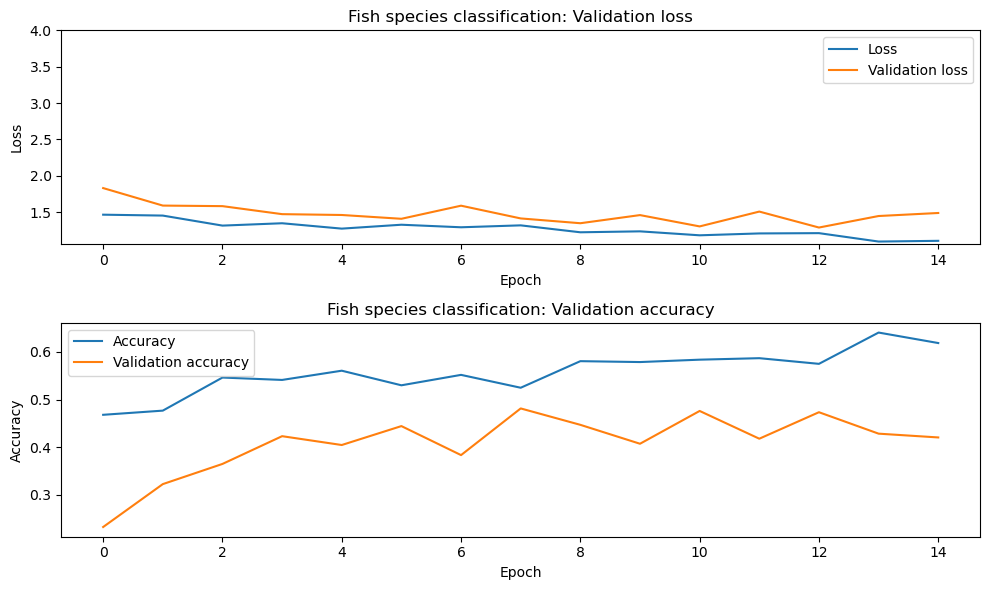

Plotting confusion matrix and report for validation data..
12/12 [==============================] - 3s 205ms/step
Classification report
              precision    recall  f1-score   support

         ALB       0.68      0.48      0.56       172
         BET       0.29      0.30      0.29        20
         DOL       0.41      0.75      0.53        12
         LAG       0.19      0.86      0.32         7
         NoF       0.88      0.30      0.45        46
       OTHER       0.39      0.60      0.47        30
       SHARK       0.33      1.00      0.49        18
         YFT       0.44      0.40      0.42        73

    accuracy                           0.48       378
   macro avg       0.45      0.59      0.44       378
weighted avg       0.58      0.48      0.49       378

Loss: 1.4115216732025146, Accuracy: 0.48148149251937866
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


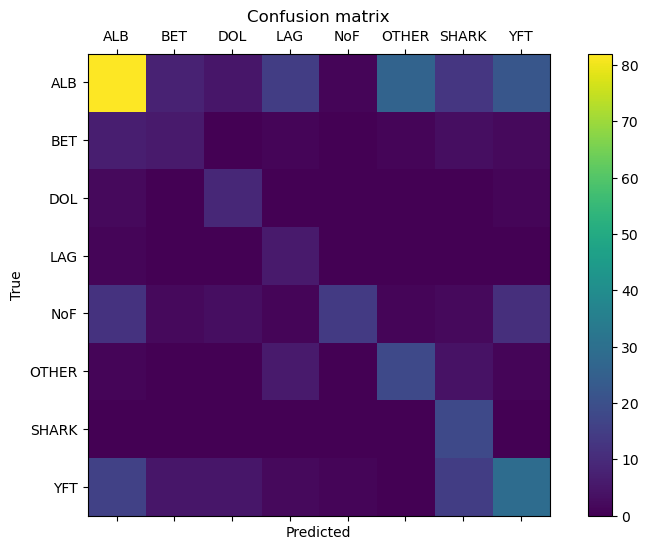

Test errors visualization
Amount of test errors: 196


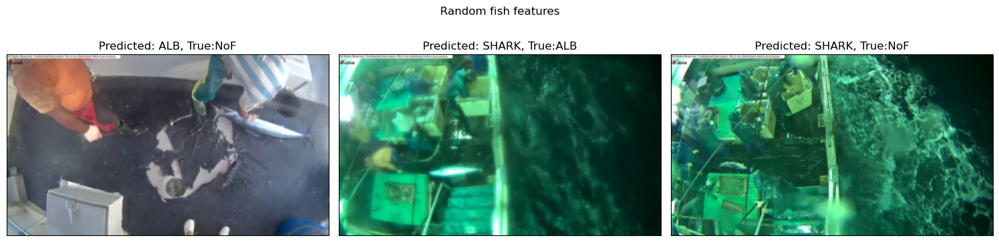

Plotting confusion matrix and report for test data..
3/3 [==============================] - 0s 119ms/step
Classification report
              precision    recall  f1-score   support

         ALB       0.72      0.58      0.64        31
         BET       1.00      0.50      0.67         4
         DOL       0.29      1.00      0.44         2
         LAG       0.33      1.00      0.50         1
         NoF       1.00      0.56      0.71         9
       OTHER       0.44      0.80      0.57         5
       SHARK       0.33      1.00      0.50         3
         YFT       0.50      0.31      0.38        13

    accuracy                           0.57        68
   macro avg       0.58      0.72      0.55        68
weighted avg       0.68      0.57      0.58        68

Loss: 1.199426293373108, Accuracy: 0.5735294222831726
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


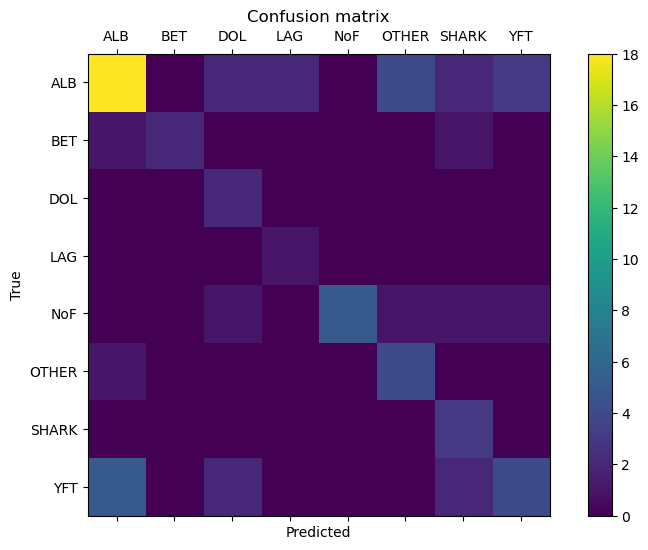

Test errors visualization
Amount of test errors: 29


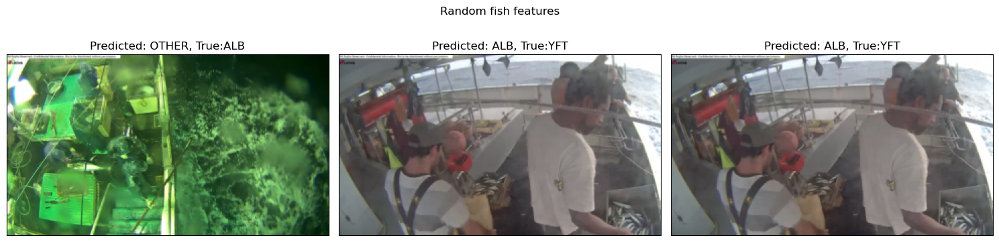

In [40]:
eval_model(baseline_train, baseline_model, fish_test_features, fish_test_labels_ohc, fish_val_features, 
           fish_val_labels_ohc, loaded=True)

The __Classification report__ shows a very balanced __F1 score and accuracy__ for both __validation and test sets__. 

Overall, the CNN looks to be producing stable results but suffers from __underfitting__.

An advantage of using __Convolutional Neural Networks__ is that we can also plot the weights and outputs that each layer produces to get a closer look what patterns the model recognizes.

To get a better look at the filters, we can correct the color intensity of the pixels - _lowest - blue, highest - red_ and compare the areas. For these visualizations, I'm going to look at the __red__ channel. 
We can also plot the grayscale output images that each convolutional layer produces. We just need to pass an input image to the __Keras function__, specifying the input and output layers.

In [41]:
def plot_conv_weights(weights, rows, cols, input_channel=0):
    w_min = np.min(weights)
    w_max = np.max(weights)

    num_filters = weights.shape[3]
    
    # Create figure with a grid of sub-plots.
    fig, axes = plt.subplots(rows, cols)
    fig.suptitle("Convolutional weights")
    # Plot all the filter-weights.
    for i, ax in enumerate(axes.flat):
        if i<num_filters:
            # Get the weights for the i'th filter of the input channel.
            img = weights[:, :, input_channel, i]

            # Plot image.
            ax.imshow(img, vmin=w_min, vmax=w_max,
                      interpolation='nearest', cmap='seismic')
        
        # Remove ticks from the plot.
        ax.set_xticks([])
        ax.set_yticks([])
    
    plt.show()

def plot_conv_output(values, rows, cols):
    # Number of filters used in the conv. layer.
    num_filters = values.shape[3]
     
    # Create figure with a grid of sub-plots.
    fig, axes = plt.subplots(rows, cols, figsize=(50,25))
    fig.suptitle("Convolutional outputs", fontsize=50)
    # Plot the output images of all the filters.
    for i, ax in enumerate(axes.flat):
        if i<num_filters:
            # Get the output image using the i'th filter.
            img = values[0, :, :, i]

            # Plot image.
            ax.imshow(img, interpolation='nearest', cmap='binary')
        
        # Remove ticks from the plot.
        ax.set_xticks([])
        ax.set_yticks([])

    plt.show()    

In [42]:
baseline_model.layers

And we'll also add some helper-functions to get the weights and outputs from a layer and call the respective methods.

In [43]:
def plot_weights(layer, rows, cols, input_channel=0):
    weights = layer.get_weights()[0]
    print("Filter shape:{}".format(weights.shape))
    print("Plotting convolutional weights..")
    
    plot_conv_weights(weights=weights, rows=rows, cols=cols, input_channel=input_channel)

def plot_outputs(input_image, input_layer, output_layer, rows, cols):
    input_image_batch = np.expand_dims(input_image, axis=0)
    output = K.function(inputs=[input_layer.input],
                          outputs=[output_layer.output])
    layer = output([[input_image_batch]])[0]
    print("Output layer shape:{}".format(layer.shape))
    print("Plotting layer output..")
    plot_conv_output(values=layer, rows=rows, cols=cols)

Filter shape:(5, 5, 3, 32)
Plotting convolutional weights..


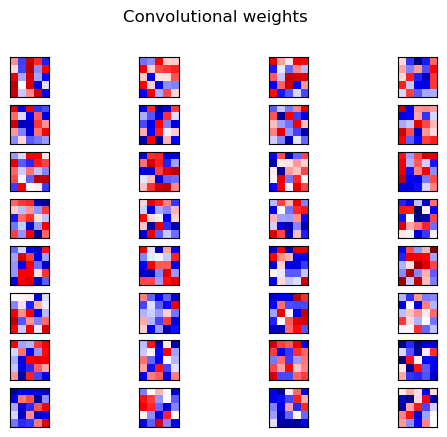

In [44]:
plot_weights(baseline_model.layers[0], rows=8, cols=4)

Filter shape:(3, 3, 32, 64)
Plotting convolutional weights..


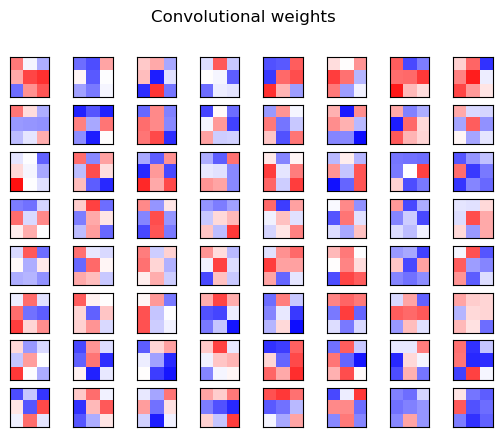

In [45]:
plot_weights(baseline_model.layers[2], rows=8, cols=8)

The kernel values for each layer seem relatively balanced. Let's look at the outputs generated for an image from the test set.

In [46]:
test_image = fish_test_features[22]

In [47]:
test_image.shape

(180, 320, 3)

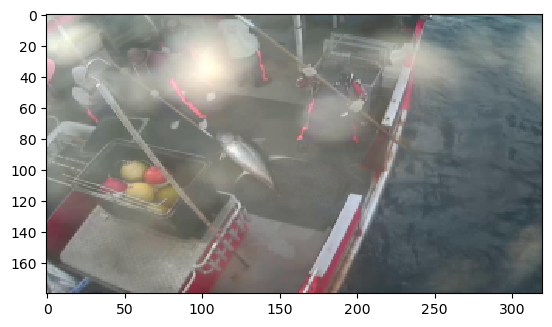

In [48]:
plot_single(test_image)

We pass this image to the network layers and observe the following results.

Output layer shape:(1, 180, 320, 32)
Plotting layer output..


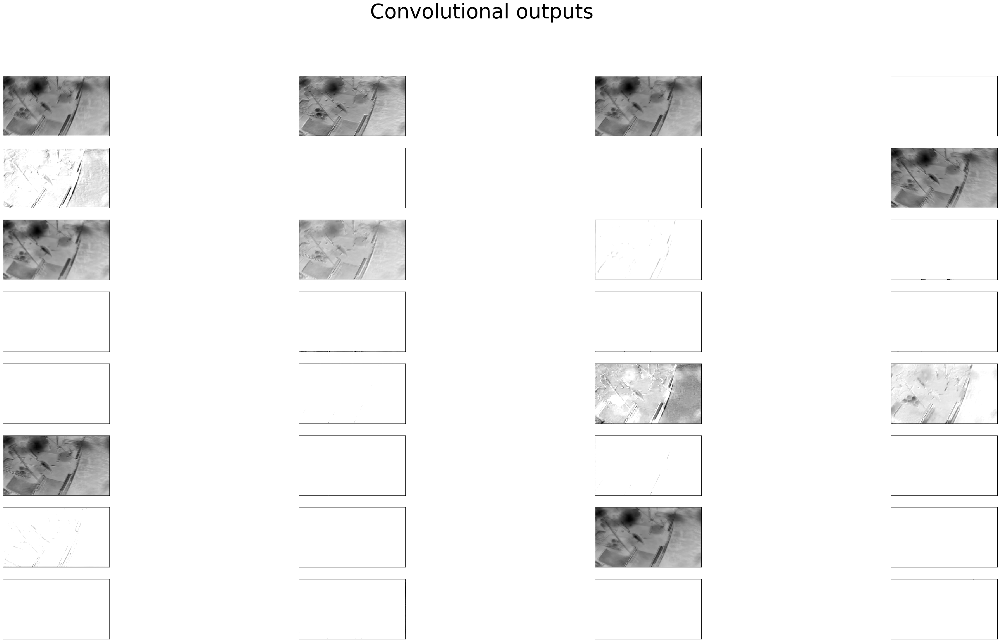

In [49]:
plot_outputs(test_image, baseline_model.layers[0], baseline_model.layers[0], rows=8, cols=4)

Output layer shape:(1, 90, 160, 32)
Plotting layer output..


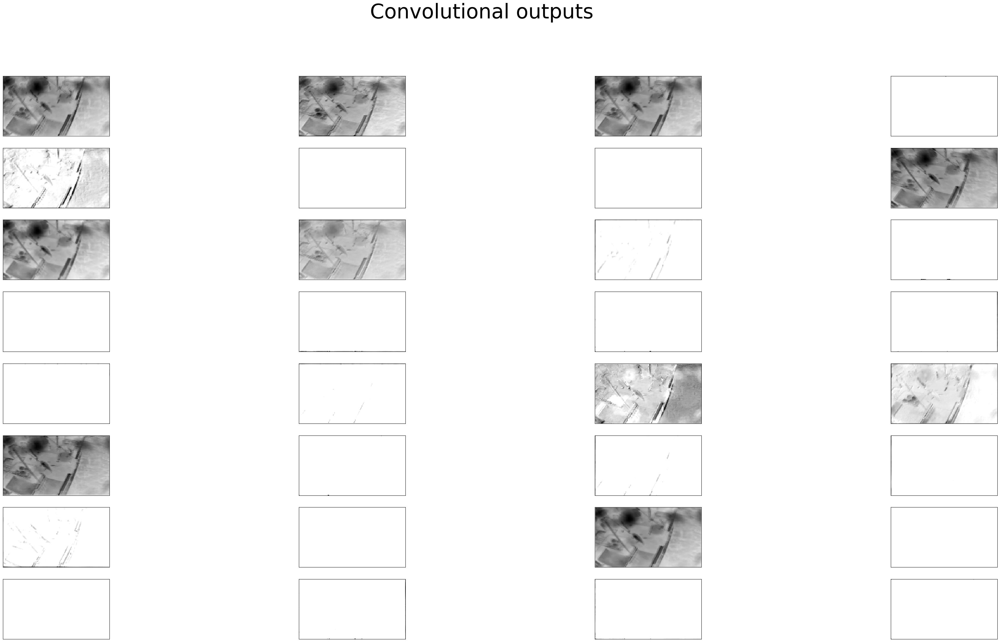

In [50]:
plot_outputs(test_image, baseline_model.layers[0], baseline_model.layers[1], rows=8, cols=4)

Output layer shape:(1, 90, 160, 64)
Plotting layer output..


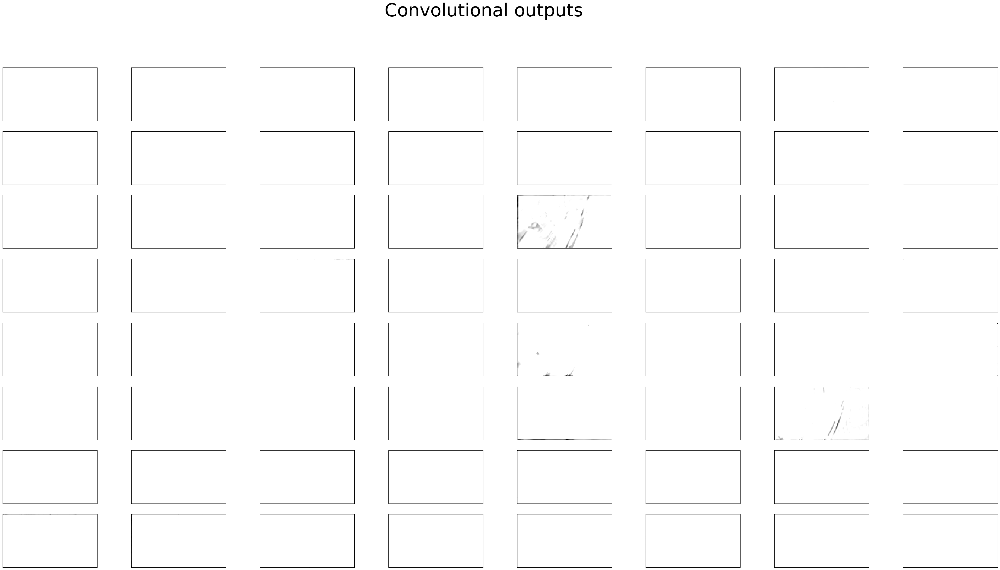

In [51]:
plot_outputs(test_image, baseline_model.layers[0], baseline_model.layers[2], rows=8, cols=8)

We can observe that the first __convolutional__ layer successfully recognizes some parts of the ship and the actual fish.

### 5. Creating and evaluating a __deeper CNN model__.

Well, the last model obviously suffered from overfitting, so what we can do is make a more complex model: __with more hidden layers and units__. I'll also try to tune the __learning rate__ in a single iteration using __learning rate decay__, which will decrease by $0.5$ for each epoch if the validation accuracy does not increase.

In [52]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience=1, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=1e-7)
deep_stopper = EarlyStopping(monitor='loss', patience=5)
deep_checkpointer = ModelCheckpoint('best_model_deep.h5',
                                monitor='val_accuracy',
                                verbose=1,
                                save_best_only=True,
                                save_weights_only=True)

I'm going to try out 3 different architectures, run them for 1 epoch, see which one is the most promising and try to optimize it.

In [53]:
aug_batch_size = 64
aug_num_epochs = 1
aug_num_steps_per_epoch = 25

First, I'm going to try a deeper CNN with 5 __convolutional layers__, 3 __pooling layers__ and some __dropout__ at the end for __regularization__ and __Batch Normalization__ to avoid __vanishing gradients__. 

In [54]:
deep_model=Sequential()

deep_model.add(Conv2D(32, kernel_size=5, input_shape=(img_w, img_h, num_channels), activation='relu', padding='same'))
deep_model.add(Conv2D(32, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(64, kernel_size=3, activation='relu', padding='same'))
deep_model.add(Conv2D(64, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(96, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Dropout(0.2))
deep_model.add(BatchNormalization())


deep_model.add(Flatten())
deep_model.add(Dense(len(fish_classes), activation='softmax'))

optimizer = Adam(learning_rate=0.001)

deep_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
print(deep_model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 180, 320, 32)      2432      
                                                                 
 conv2d_3 (Conv2D)           (None, 180, 320, 32)      25632     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 90, 160, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_4 (Conv2D)           (None, 90, 160, 64)       18496     
                                                                 
 conv2d_5 (Conv2D)           (None, 90, 160, 64)       36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 45, 80, 64)        0         
 g2D)                                                 

In [94]:
deep_hist = deep_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[deep_checkpointer, learning_rate_reduction, deep_stopper])

25/25 [==============================] - ETA: 0s - loss: 1.4403 - accuracy: 0.4923
Epoch 1: val_accuracy improved from -inf to 0.05820, saving model to best_model_deep.h5
25/25 [==============================] - 226s 9s/step - loss: 1.4403 - accuracy: 0.4923 - val_loss: 1.8454 - val_accuracy: 0.0582 - lr: 0.0010


This model seems promising, but let's try to find a more complex one.

Next, I'm going to try adding another __convolutional layer__ to increase the complexity even more and increase the dropout a little bit..

In [55]:
deep_model=Sequential()

deep_model.add(Conv2D(32, kernel_size=5, input_shape=(img_w, img_h, num_channels), activation='relu', padding='same'))
deep_model.add(Conv2D(32, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(64, kernel_size=5, activation='relu', padding='same'))
deep_model.add(Conv2D(64, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(96, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Conv2D(128, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Dropout(0.3))
deep_model.add(BatchNormalization())


deep_model.add(Flatten())
deep_model.add(Dense(len(fish_classes), activation='softmax'))

optimizer = Adam(learning_rate=0.001)

deep_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
print(deep_model.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 180, 320, 32)      2432      
                                                                 
 conv2d_8 (Conv2D)           (None, 180, 320, 32)      25632     
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 90, 160, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_9 (Conv2D)           (None, 90, 160, 64)       51264     
                                                                 
 conv2d_10 (Conv2D)          (None, 90, 160, 64)       102464    
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 45, 80, 64)        0         
 g2D)                                                 

In [97]:
deep_hist = deep_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[deep_checkpointer, learning_rate_reduction, deep_stopper])

25/25 [==============================] - ETA: 0s - loss: 1.8409 - accuracy: 0.3187 
Epoch 1: val_accuracy improved from 0.07937 to 0.15079, saving model to best_model_deep.h5
25/25 [==============================] - 316s 13s/step - loss: 1.8409 - accuracy: 0.3187 - val_loss: 2.0143 - val_accuracy: 0.1508 - lr: 0.0010


This model seems to close the generalization gap the most and looks very promising.

Finally, I'll try a similar deep model, but with more hidden units and two __dropout__ and __normalization__ layers.

In [56]:
deep_model=Sequential()

deep_model.add(Conv2D(32, kernel_size=7, input_shape=(img_w, img_h, num_channels), activation='relu', padding='same'))
deep_model.add(Conv2D(64, kernel_size=7, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(96, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Dropout(0.3))
deep_model.add(BatchNormalization())

deep_model.add(Conv2D(128, kernel_size=3, activation='relu', padding='same'))
deep_model.add(Conv2D(256, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Dropout(0.3))
deep_model.add(BatchNormalization())


deep_model.add(Flatten())
deep_model.add(Dense(len(fish_classes), activation='softmax'))

optimizer = Adam(learning_rate=0.001)

deep_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
print(deep_model.summary())

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_13 (Conv2D)          (None, 180, 320, 32)      4736      
                                                                 
 conv2d_14 (Conv2D)          (None, 180, 320, 64)      100416    
                                                                 
 max_pooling2d_8 (MaxPoolin  (None, 90, 160, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_15 (Conv2D)          (None, 90, 160, 96)       153696    
                                                                 
 max_pooling2d_9 (MaxPoolin  (None, 45, 80, 96)        0         
 g2D)                                                            
                                                                 
 dropout_2 (Dropout)         (None, 45, 80, 96)       

In [88]:
deep_hist = deep_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                       callbacks=[deep_checkpointer, learning_rate_reduction, deep_stopper])

Epoch 1/15
25/25 [==============================] - ETA: 0s - loss: 4.8315 - accuracy: 0.2149 
Epoch 1: val_accuracy improved from -inf to 0.17725, saving model to best_model_deep.h5
25/25 [==============================] - 569s 23s/step - loss: 4.8315 - accuracy: 0.2149 - val_loss: 3.2066 - val_accuracy: 0.1772 - lr: 0.0010
Epoch 2/15
25/25 [==============================] - ETA: 0s - loss: 4.3861 - accuracy: 0.2719 
Epoch 2: val_accuracy improved from 0.17725 to 0.41005, saving model to best_model_deep.h5
25/25 [==============================] - 577s 23s/step - loss: 4.3861 - accuracy: 0.2719 - val_loss: 2.9858 - val_accuracy: 0.4101 - lr: 0.0010
Epoch 3/15
25/25 [==============================] - ETA: 0s - loss: 4.1367 - accuracy: 0.2875 
Epoch 3: val_accuracy did not improve from 0.41005

Epoch 3: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
25/25 [==============================] - 633s 25s/step - loss: 4.1367 - accuracy: 0.2875 - val_loss: 13.8305 - val_accur

In [89]:
#deep_model.save_weights('best_model_deep_3.h5')
#save_hist('deep_hist3.json', str(deep_hist.history))

In [57]:
#save_hist('deep_hist3.json', str(deep_hist.history))
deep_hist3 = load_hist('deep_hist3.json')
deep_model.load_weights('best_model_deep_3.h5')

In [58]:
print(deep_hist3)


{'loss': [4.831512451171875, 4.386096954345703, 4.1367268562316895, 3.9386398792266846, 3.4974114894866943, 3.304959297180176, 3.0755615234375, 2.9085237979888916, 2.836599826812744, 2.9731175899505615, 2.7538182735443115, 2.7003355026245117, 2.9696156978607178, 2.7618651390075684, 2.8118462562561035], 'accuracy': [0.21492347121238708, 0.2718749940395355, 0.2874999940395355, 0.36000001430511475, 0.3581250011920929, 0.38749998807907104, 0.4025000035762787, 0.43558672070503235, 0.4375, 0.42500001192092896, 0.42875000834465027, 0.44312500953674316, 0.4074999988079071, 0.43937501311302185, 0.43937501311302185], 'val_loss': [3.2066359519958496, 2.9858391284942627, 13.83050537109375, 12.303528785705566, 13.892972946166992, 15.716974258422852, 15.154680252075195, 15.642054557800293, 15.78741455078125, 15.249835968017578, 15.287925720214844, 15.60932445526123, 15.798507690429688, 16.017961502075195, 16.21480941772461], 'val_accuracy': [0.17724867165088654, 0.4100528955459595, 0.068783067166805

In [59]:
deep_hist_dict = ast.literal_eval(deep_hist3)

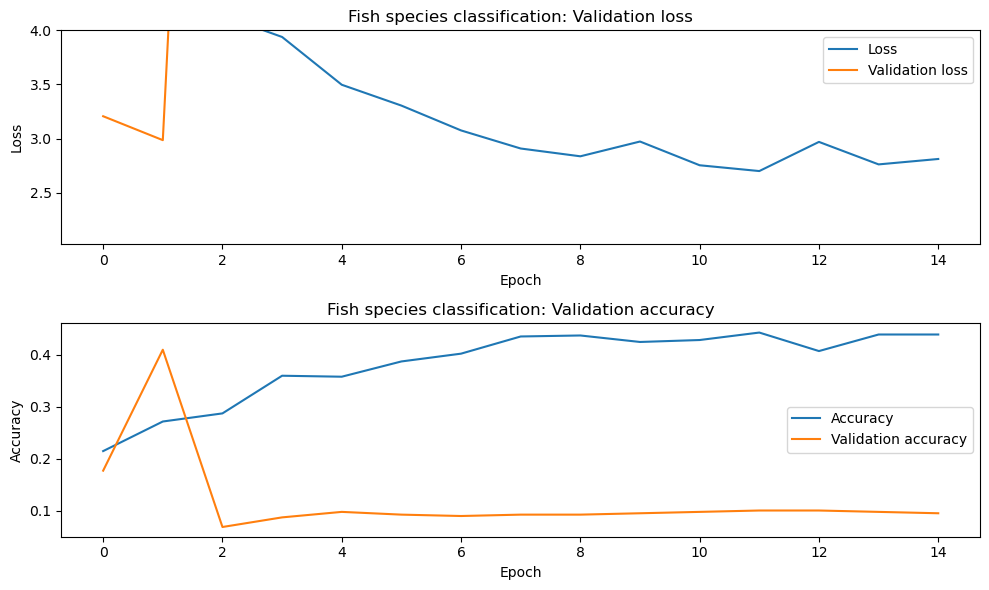

Plotting confusion matrix and report for validation data..
12/12 [==============================] - 27s 2s/step
Classification report
              precision    recall  f1-score   support

         ALB       0.00      0.00      0.00       172
         BET       0.00      0.00      0.00        20
         DOL       0.25      0.17      0.20        12
         LAG       0.05      1.00      0.09         7
         NoF       1.00      0.20      0.33        46
       OTHER       0.00      0.00      0.00        30
       SHARK       0.09      1.00      0.16        18
         YFT       0.00      0.00      0.00        73

    accuracy                           0.10       378
   macro avg       0.17      0.30      0.10       378
weighted avg       0.13      0.10      0.06       378



C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Loss: 16.21480941772461, Accuracy: 0.095238097012043
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_5328\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_5328\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


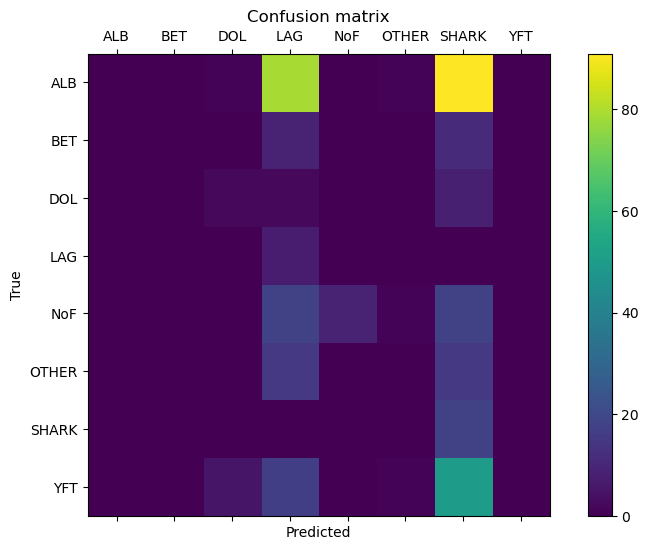

Test errors visualization
Amount of test errors: 342


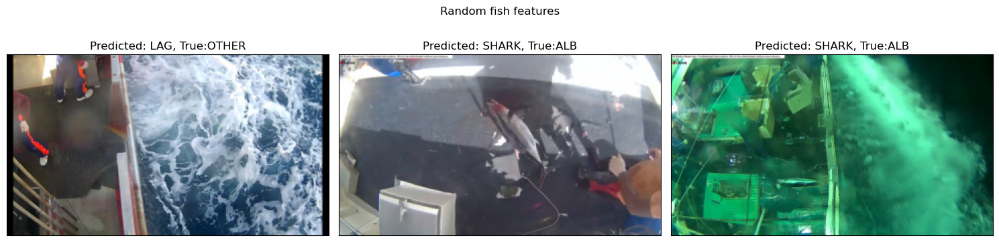

Plotting confusion matrix and report for test data..
3/3 [==============================] - 6s 2s/step
Classification report
              precision    recall  f1-score   support

         ALB       0.00      0.00      0.00        31
         BET       0.00      0.00      0.00         4
         DOL       0.00      0.00      0.00         2
         LAG       0.05      1.00      0.09         1
         NoF       0.00      0.00      0.00         9
       OTHER       0.00      0.00      0.00         5
       SHARK       0.07      1.00      0.12         3
         YFT       0.00      0.00      0.00        13

    accuracy                           0.06        68
   macro avg       0.01      0.25      0.03        68
weighted avg       0.00      0.06      0.01        68



C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Bhushan\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Loss: 16.23689842224121, Accuracy: 0.05882352963089943
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_5328\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_5328\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


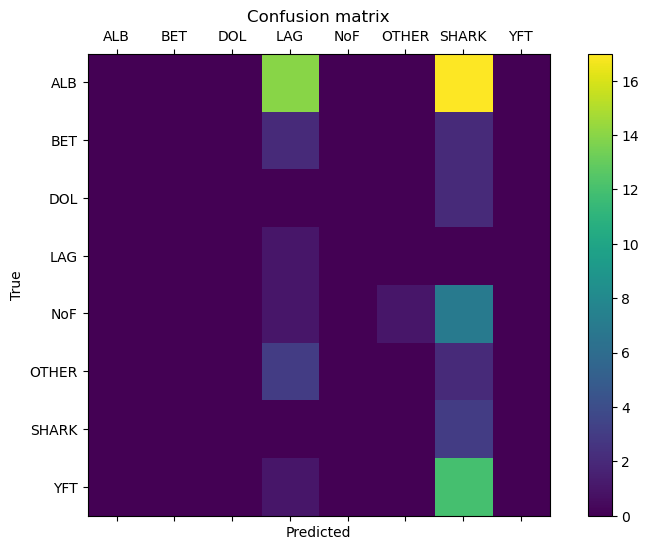

Test errors visualization
Amount of test errors: 64


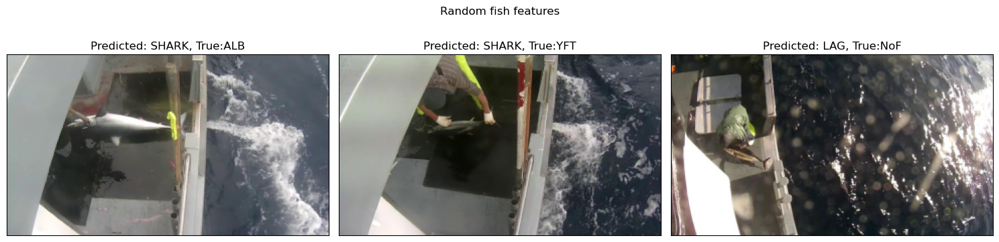

In [93]:
eval_model(deep_hist_dict, deep_model, fish_test_features, fish_test_labels_ohc, fish_val_features, fish_val_labels_ohc, loaded=True, top_lim=None)

This model may suffer from overfitting as the loss functions already start to differ greatly. __The most promising out of the 3 was the second model__, so let's iterate over it some more.

In [60]:
deep_model=Sequential()

deep_model.add(Conv2D(32, kernel_size=5, input_shape=(img_w, img_h, num_channels), activation='relu', padding='same'))
deep_model.add(Conv2D(32, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(64, kernel_size=5, activation='relu', padding='same'))
deep_model.add(Conv2D(64, kernel_size=5, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))

deep_model.add(Conv2D(96, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Conv2D(128, kernel_size=3, activation='relu', padding='same'))
deep_model.add(MaxPool2D(2))
deep_model.add(Dropout(0.3))
deep_model.add(BatchNormalization())


deep_model.add(Flatten())
deep_model.add(Dense(len(fish_classes), activation='softmax'))

optimizer = Adam(learning_rate=0.001)

deep_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
print(deep_model.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 180, 320, 32)      2432      
                                                                 
 conv2d_19 (Conv2D)          (None, 180, 320, 32)      25632     
                                                                 
 max_pooling2d_11 (MaxPooli  (None, 90, 160, 32)       0         
 ng2D)                                                           
                                                                 
 conv2d_20 (Conv2D)          (None, 90, 160, 64)       51264     
                                                                 
 conv2d_21 (Conv2D)          (None, 90, 160, 64)       102464    
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 45, 80, 64)        0         
 ng2D)                                                

In [61]:
aug_batch_size = 64
aug_num_epochs = 15
aug_num_steps_per_epoch = 25

In [103]:
deep_hist = deep_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[deep_checkpointer, learning_rate_reduction, deep_stopper])

Epoch 1/15
25/25 [==============================] - ETA: 0s - loss: 1.2423 - accuracy: 0.5550 
Epoch 1: val_accuracy improved from 0.47354 to 0.48677, saving model to best_model_deep.h5
25/25 [==============================] - 314s 13s/step - loss: 1.2423 - accuracy: 0.5550 - val_loss: 1.5898 - val_accuracy: 0.4868 - lr: 1.5625e-05
Epoch 2/15
25/25 [==============================] - ETA: 0s - loss: 1.2357 - accuracy: 0.5625 
Epoch 2: val_accuracy improved from 0.48677 to 0.50794, saving model to best_model_deep.h5
25/25 [==============================] - 310s 12s/step - loss: 1.2357 - accuracy: 0.5625 - val_loss: 1.5665 - val_accuracy: 0.5079 - lr: 1.5625e-05
Epoch 3/15
25/25 [==============================] - ETA: 0s - loss: 1.1728 - accuracy: 0.6019 
Epoch 3: val_accuracy did not improve from 0.50794

Epoch 3: ReduceLROnPlateau reducing learning rate to 7.812500371073838e-06.
25/25 [==============================] - 310s 12s/step - loss: 1.1728 - accuracy: 0.6019 - val_loss: 1.5297 -

The validation accuracy is actually a little bit less than the base model, but this one seems to produce more stable results. Let's save the weights and evaluate it.

In [104]:
#deep_model.save_weights('best_model_deep_end.h5')

In [62]:
#save_hist('deep_hist.json', str(deep_hist.history))
deep_hist = load_hist('deep_hist.json')
deep_model.load_weights('best_model_deep_end.h5')

In [63]:
print(deep_hist)


{'loss': [1.242272973060608, 1.2357094287872314, 1.1728438138961792, 1.2166109085083008, 1.1773028373718262, 1.2369709014892578, 1.196692943572998, 1.2084126472473145], 'accuracy': [0.5550000071525574, 0.5625, 0.6018750071525574, 0.5687500238418579, 0.5899999737739563, 0.5687500238418579, 0.5762500166893005, 0.5818750262260437], 'val_loss': [1.5898431539535522, 1.5665459632873535, 1.5296711921691895, 1.5019903182983398, 1.4773995876312256, 1.4573054313659668, 1.4366514682769775, 1.4191776514053345], 'val_accuracy': [0.48677247762680054, 0.5079365372657776, 0.4920634925365448, 0.5132275223731995, 0.5185185074806213, 0.5105820298194885, 0.4841269850730896, 0.47883597016334534], 'lr': [1.5625e-05, 1.5625e-05, 1.5625e-05, 7.8125e-06, 7.8125e-06, 7.8125e-06, 3.90625e-06, 1.953125e-06]}


In [64]:
deep_hist_dict1 = ast.literal_eval(deep_hist)

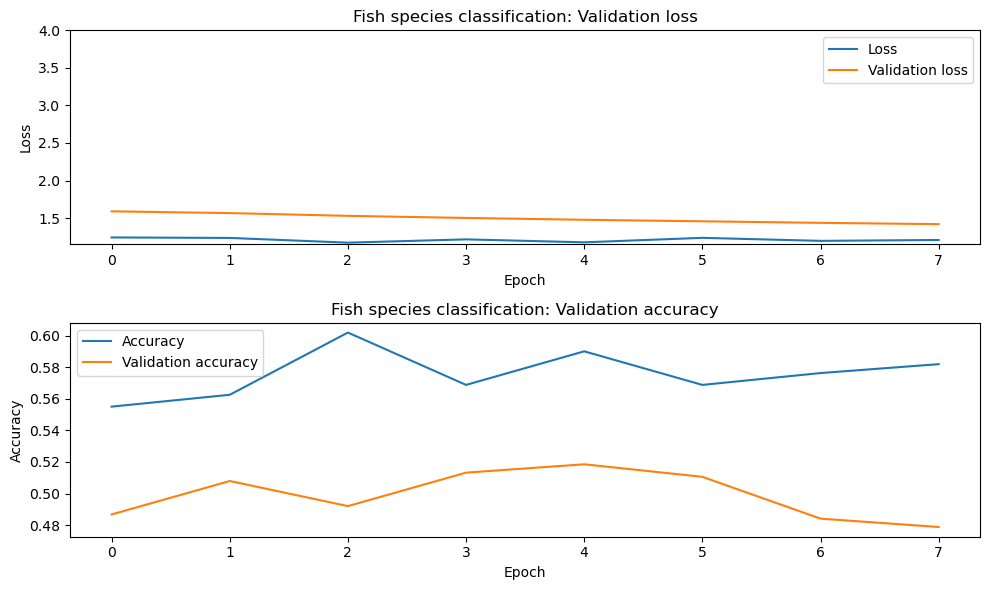

Plotting confusion matrix and report for validation data..
12/12 [==============================] - 13s 1s/step
Classification report
              precision    recall  f1-score   support

         ALB       0.73      0.40      0.51       172
         BET       0.24      0.50      0.32        20
         DOL       0.33      0.67      0.44        12
         LAG       0.25      0.86      0.39         7
         NoF       0.60      0.65      0.63        46
       OTHER       0.42      0.57      0.49        30
       SHARK       0.37      0.39      0.38        18
         YFT       0.41      0.48      0.44        73

    accuracy                           0.48       378
   macro avg       0.42      0.56      0.45       378
weighted avg       0.56      0.48      0.49       378

Loss: 1.4191776514053345, Accuracy: 0.47883597016334534
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


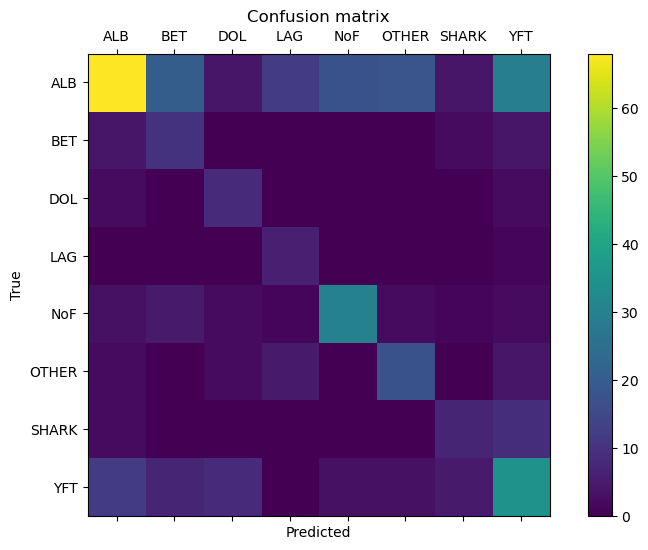

Test errors visualization
Amount of test errors: 197


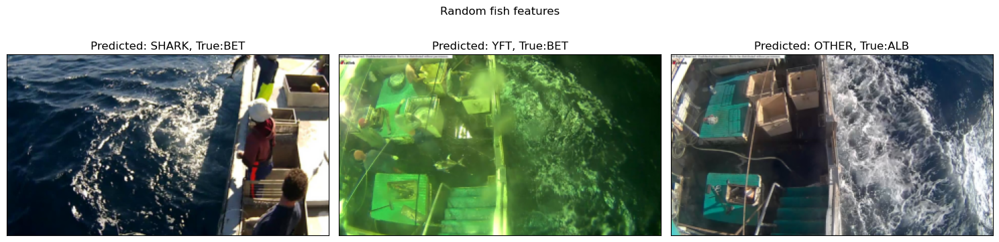

Plotting confusion matrix and report for test data..
3/3 [==============================] - 2s 656ms/step
Classification report
              precision    recall  f1-score   support

         ALB       0.90      0.58      0.71        31
         BET       0.33      0.50      0.40         4
         DOL       0.20      0.50      0.29         2
         LAG       1.00      1.00      1.00         1
         NoF       0.64      0.78      0.70         9
       OTHER       0.60      0.60      0.60         5
       SHARK       0.75      1.00      0.86         3
         YFT       0.62      0.77      0.69        13

    accuracy                           0.66        68
   macro avg       0.63      0.72      0.65        68
weighted avg       0.73      0.66      0.67        68

Loss: 1.3062105178833008, Accuracy: 0.6617646813392639
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_16828\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


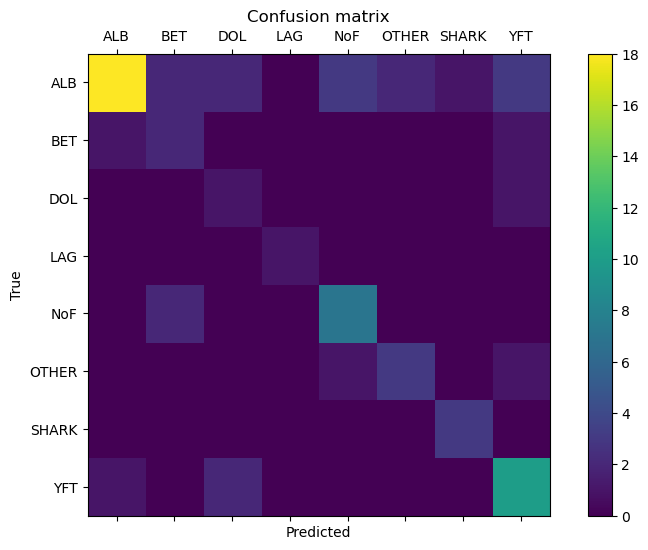

Test errors visualization
Amount of test errors: 23


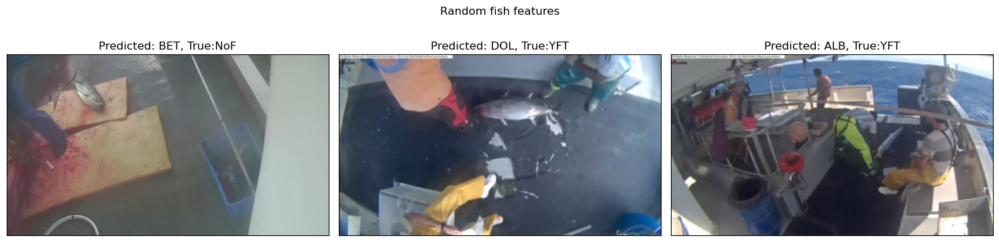

In [65]:
eval_model(deep_hist_dict1, deep_model, fish_test_features, fish_test_labels_ohc, fish_val_features, fish_val_labels_ohc, loaded=True, top_lim=None)

Let's see what the kernels and outputs look like.

In [70]:
deep_model.layers

Filter shape:(5, 5, 3, 32)
Plotting convolutional weights..


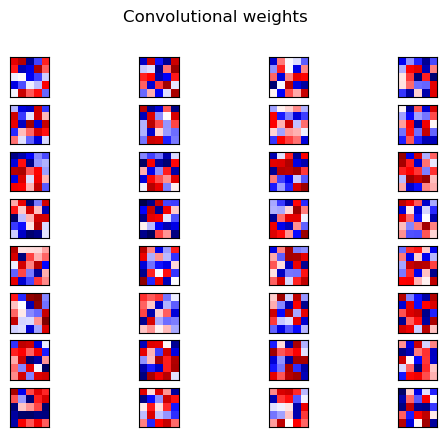

In [71]:
plot_weights(deep_model.layers[0], rows=8, cols=4)

Filter shape:(5, 5, 32, 32)
Plotting convolutional weights..


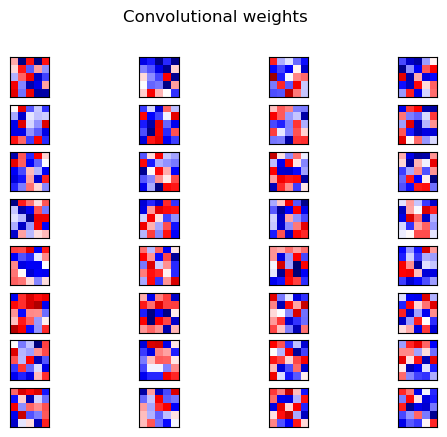

In [72]:
plot_weights(deep_model.layers[1], rows=8, cols=4)

Filter shape:(5, 5, 32, 64)
Plotting convolutional weights..


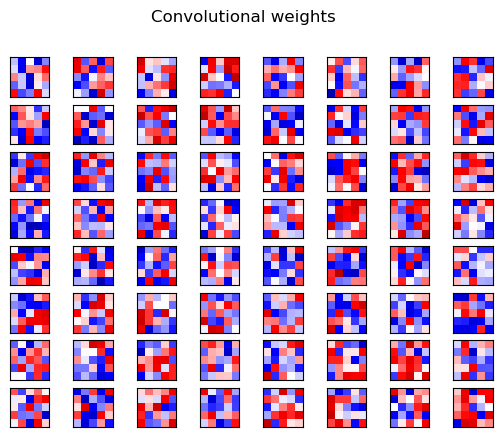

In [73]:
plot_weights(deep_model.layers[3], rows=8, cols=8)

Filter shape:(5, 5, 64, 64)
Plotting convolutional weights..


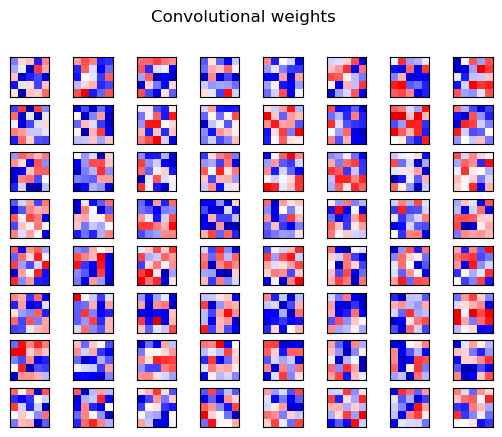

In [74]:
plot_weights(deep_model.layers[4], rows=8, cols=8)

Filter shape:(3, 3, 64, 96)
Plotting convolutional weights..


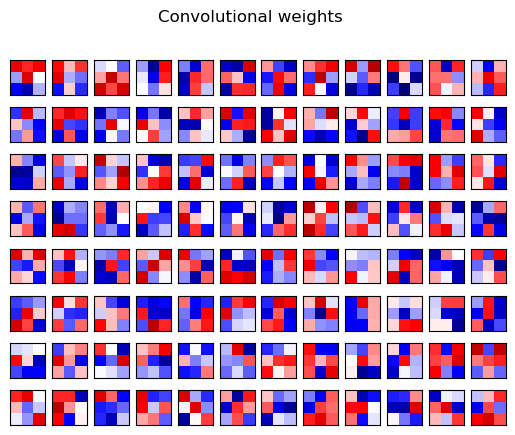

In [75]:
plot_weights(deep_model.layers[6], rows=8, cols=12)

Filter shape:(3, 3, 96, 128)
Plotting convolutional weights..


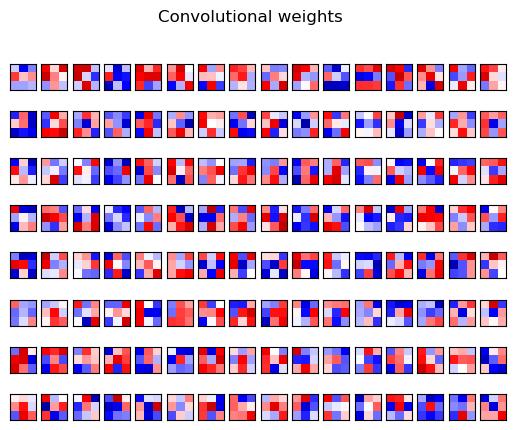

In [76]:
plot_weights(deep_model.layers[8], rows=8, cols=16)

The kernels seem relatively balanced, so let's look at the outputs.

Output layer shape:(1, 180, 320, 32)
Plotting layer output..


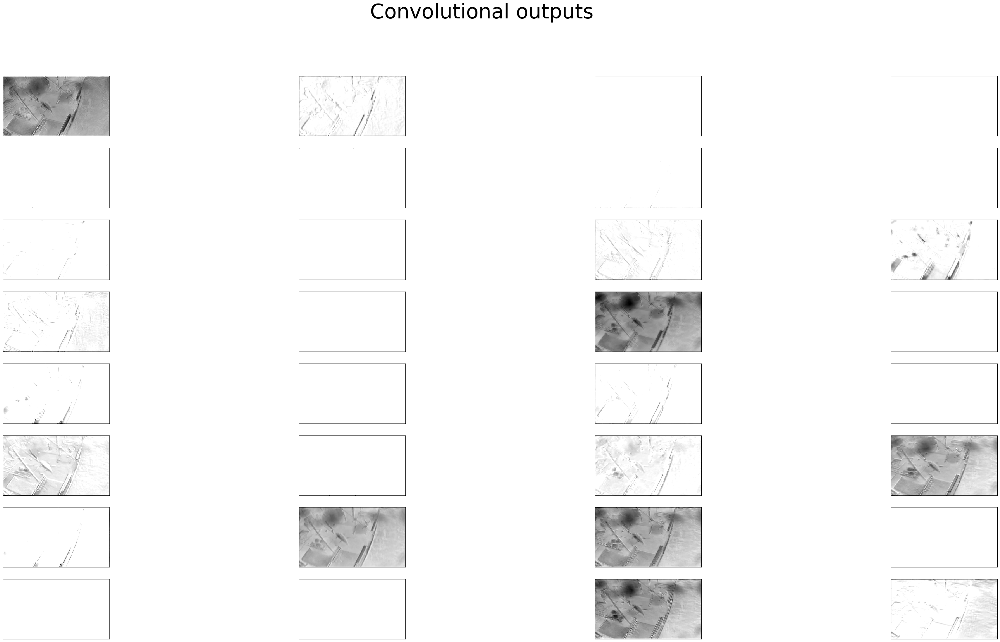

In [77]:
plot_outputs(test_image, deep_model.layers[0], deep_model.layers[0], rows=8, cols=4)

Output layer shape:(1, 90, 160, 64)
Plotting layer output..


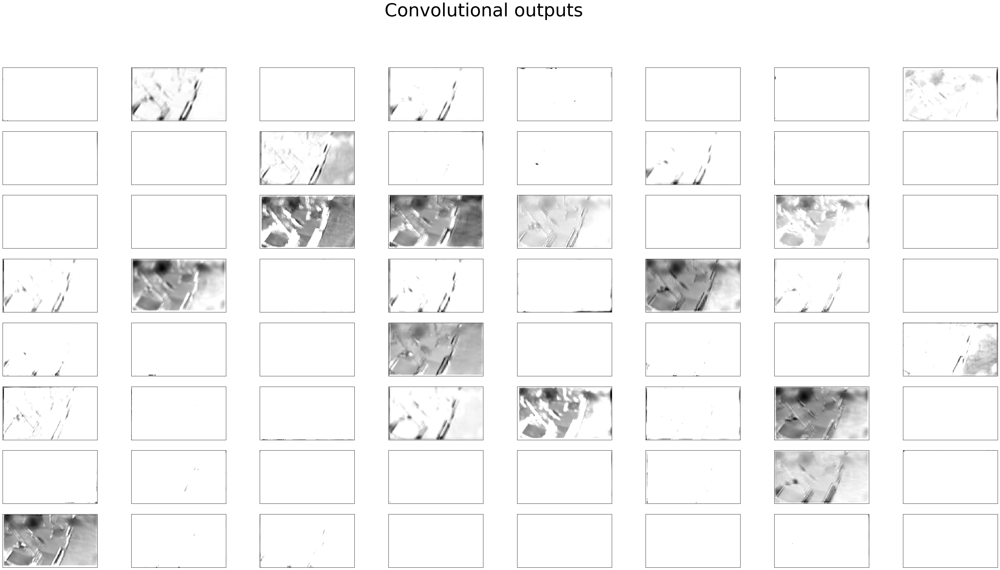

In [78]:
plot_outputs(test_image, deep_model.layers[0], deep_model.layers[3], rows=8, cols=8)

Output layer shape:(1, 45, 80, 96)
Plotting layer output..


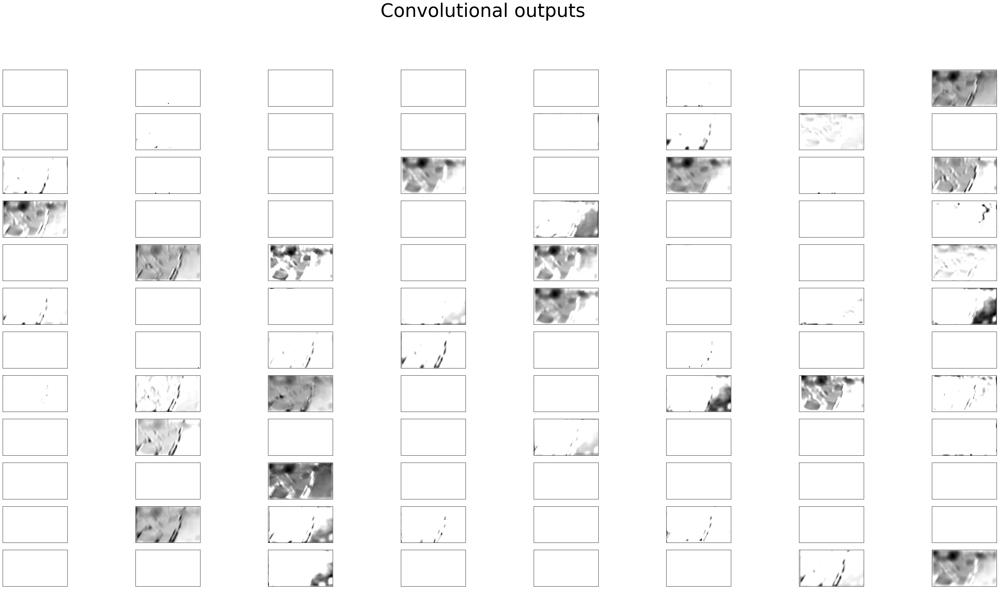

In [79]:
plot_outputs(test_image, deep_model.layers[0], deep_model.layers[6], rows=12, cols=8)

### 6. Applying transfer learning using __VGG19__ to classify the species.

I'll try out VGG19, since it's one of the most consistent and simple architectures. First, I'll use __Keras__ to download the model, specifying custom image shapes and confirm that the model looks fine, by printing the summary.

In [135]:
vgg19_model = VGG19(include_top=False, input_shape=(img_w, img_h, num_channels))

80134624/80134624 [==============================] - 12s 0us/step


In [136]:
vgg19_model.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 320, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 180, 320, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 180, 320, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 90, 160, 64)       0         
                                                                 
 block2_conv1 (Conv2D)       (None, 90, 160, 128)      73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 90, 160, 128)      147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 45, 80, 128)       0     

Next we'll choose a starting __learning rate__ and simply add a custom __FC__ layer that outputs the classes that we need.

In [138]:
optimizer = Adam(learning_rate=1e-4)
transfer_model = Sequential()
transfer_model.add(vgg19_model)
transfer_model.add(Flatten())
transfer_model.add(Dense(len(fish_classes), activation='softmax'))
transfer_model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
print(transfer_model.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 5, 10, 512)        20024384  
                                                                 
 flatten_4 (Flatten)         (None, 25600)             0         
                                                                 
 dense_4 (Dense)             (None, 8)                 204808    
                                                                 
Total params: 20229192 (77.17 MB)
Trainable params: 20229192 (77.17 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
None


I will also add similar callbacks as before - the __learning rate decay__ object will this time monitor the __validation loss__.

In [146]:
transfer_reduction = ReduceLROnPlateau(monitor='val_loss', 
                                            patience=1, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=1e-7)
transfer_stopper = EarlyStopping(monitor='val_loss', patience=3)
transfer_checkpointer = ModelCheckpoint('best_model_transfer.h5',
                                monitor='val_accuracy',
                                verbose=1,
                                save_best_only=True,
                                save_weights_only=True)

This time, I will decrease the steps per epoch to __10__, because training will be time-consuming.

In [167]:
aug_batch_size = 64
aug_num_epochs = 15
aug_num_steps_per_epoch = 10

In [148]:
transfer_hist = transfer_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[transfer_reduction, transfer_stopper, transfer_checkpointer])

Epoch 1/15
10/10 [==============================] - ETA: 0s - loss: 1.0738 - accuracy: 0.6047 
Epoch 1: val_accuracy improved from -inf to 0.52910, saving model to best_model_transfer.h5
10/10 [==============================] - 485s 50s/step - loss: 1.0738 - accuracy: 0.6047 - val_loss: 1.2536 - val_accuracy: 0.5291 - lr: 7.8125e-07
Epoch 2/15
10/10 [==============================] - ETA: 0s - loss: 1.0159 - accuracy: 0.6469 
Epoch 2: val_accuracy improved from 0.52910 to 0.53175, saving model to best_model_transfer.h5
10/10 [==============================] - 484s 49s/step - loss: 1.0159 - accuracy: 0.6469 - val_loss: 1.2510 - val_accuracy: 0.5317 - lr: 7.8125e-07
Epoch 3/15
10/10 [==============================] - ETA: 0s - loss: 0.9571 - accuracy: 0.6453 
Epoch 3: val_accuracy did not improve from 0.53175
10/10 [==============================] - 485s 49s/step - loss: 0.9571 - accuracy: 0.6453 - val_loss: 1.2457 - val_accuracy: 0.5238 - lr: 7.8125e-07
Epoch 4/15
10/10 [===============

The __VGG19__ model definitely shows improvement over the other two models. Let's save the weights and history and plot the results. 

In [149]:
joblib.dump(transfer_hist.history, 'transfer_hist.jbl')
transfer_hist_loaded = joblib.load('transfer_hist.jbl')
transfer_model.load_weights('best_model_transfer.h5')

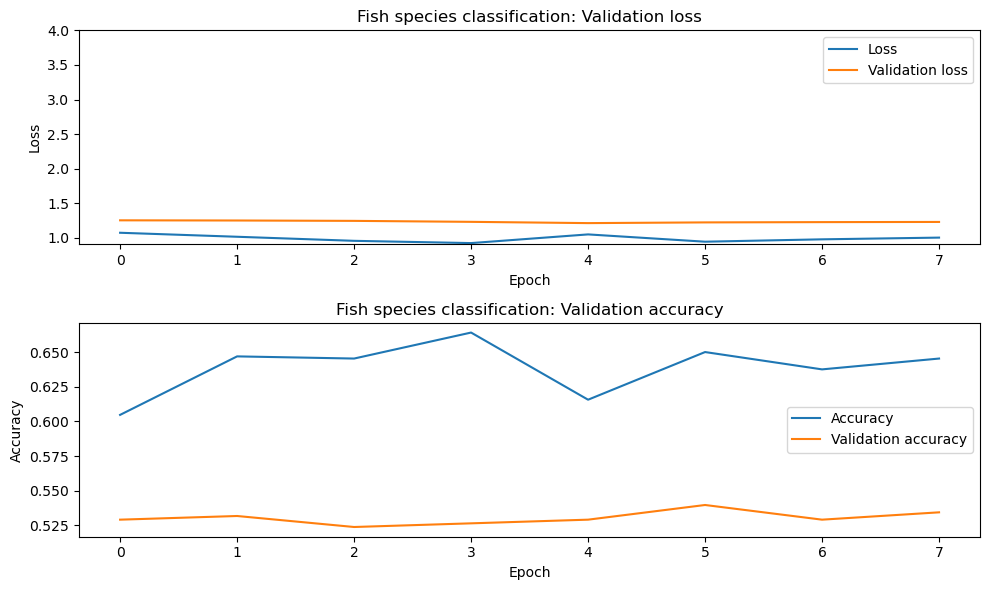

Plotting confusion matrix and report for validation data..
12/12 [==============================] - 61s 5s/step
Classification report
              precision    recall  f1-score   support

         ALB       0.79      0.35      0.49       172
         BET       0.31      0.75      0.43        20
         DOL       0.36      0.75      0.49        12
         LAG       0.39      1.00      0.56         7
         NoF       0.69      0.78      0.73        46
       OTHER       0.42      0.83      0.56        30
       SHARK       0.45      1.00      0.62        18
         YFT       0.58      0.45      0.51        73

    accuracy                           0.54       378
   macro avg       0.50      0.74      0.55       378
weighted avg       0.65      0.54      0.53       378

Loss: 1.2235413789749146, Accuracy: 0.5396825671195984
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_8676\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_8676\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


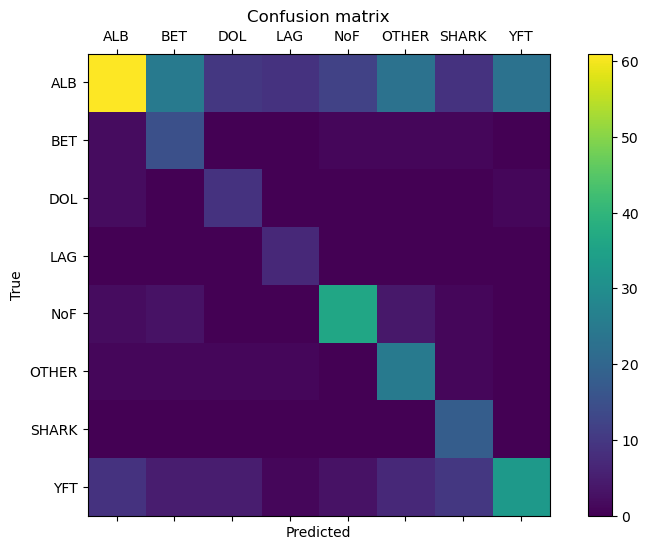

Test errors visualization
Amount of test errors: 174


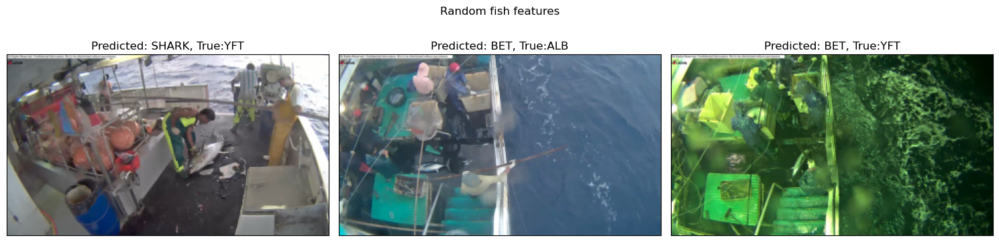

Plotting confusion matrix and report for test data..
3/3 [==============================] - 12s 3s/step
Classification report
              precision    recall  f1-score   support

         ALB       0.81      0.42      0.55        31
         BET       0.43      0.75      0.55         4
         DOL       0.67      1.00      0.80         2
         LAG       1.00      1.00      1.00         1
         NoF       0.70      0.78      0.74         9
       OTHER       0.18      0.40      0.25         5
       SHARK       0.43      1.00      0.60         3
         YFT       0.77      0.77      0.77        13

    accuracy                           0.60        68
   macro avg       0.62      0.76      0.66        68
weighted avg       0.70      0.60      0.61        68

Loss: 1.189937949180603, Accuracy: 0.6029411554336548
Confusion matrix.


C:\Users\Bhushan\AppData\Local\Temp\ipykernel_8676\1534192655.py:32: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels([''] + fish_classes)
C:\Users\Bhushan\AppData\Local\Temp\ipykernel_8676\1534192655.py:33: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([''] + fish_classes)


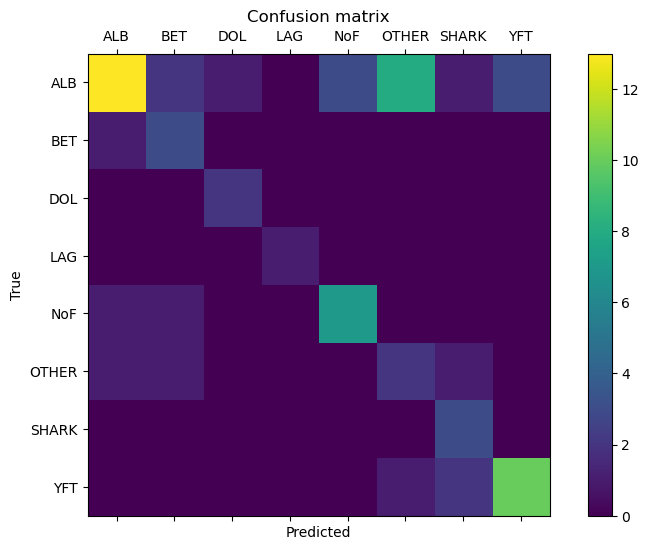

Test errors visualization
Amount of test errors: 27


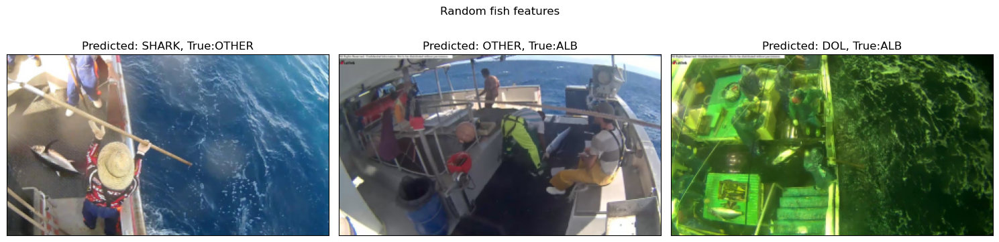

In [151]:
eval_model(transfer_hist_loaded, transfer_model, test_features=fish_test_features, test_labels=fish_test_labels_ohc,
          val_features=fish_val_features, val_labels=fish_val_labels_ohc, top_lim=None, loaded=True)

The learning curve shows much better results, the classification report is a lot more balanced and even recognizes classes with __one or two__ samples. The errors are mostly related to detecting whether a fish is present in the image or not. Overall, this model is a nice improvement to the previous ones.

In [152]:
transfer_model.layers

Filter shape:(3, 3, 3, 64)
Plotting convolutional weights..


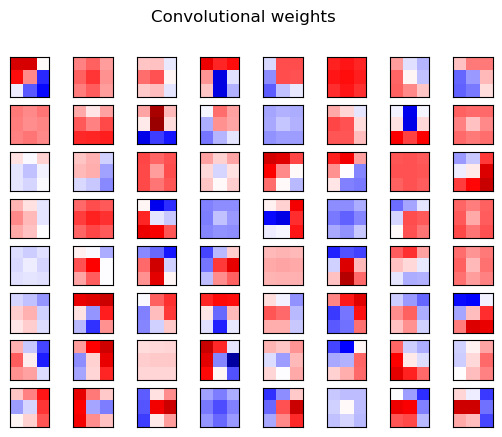

In [153]:
plot_weights(transfer_model.layers[0], rows=8, cols=8)

The kernel values seem less random and more closely related to each other.

In [155]:
vgg19_model.layers

Output layer shape:(1, 180, 320, 64)
Plotting layer output..


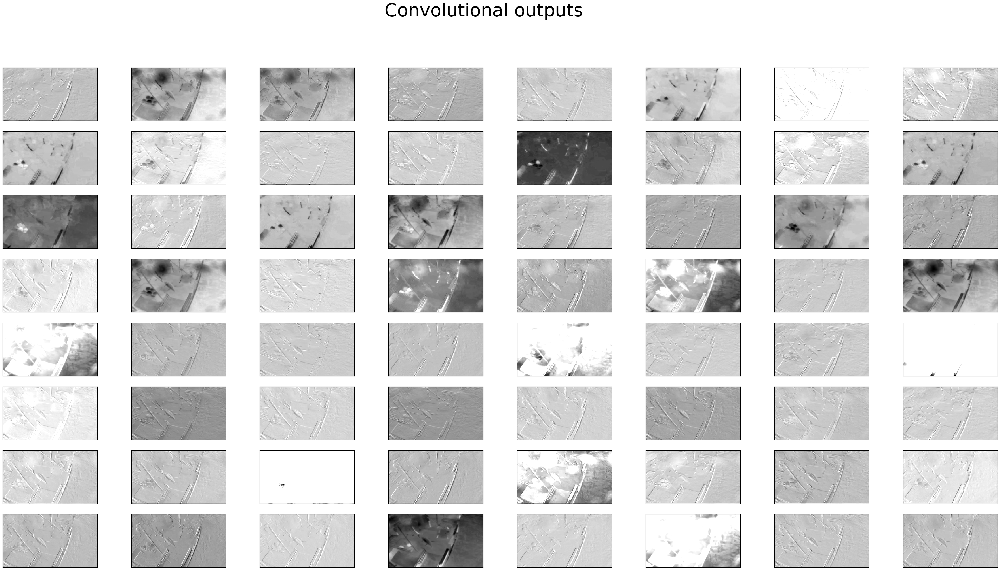

In [156]:
plot_outputs(test_image, vgg19_model.layers[1], vgg19_model.layers[1], rows=8, cols=8)

The deeper convolutional layers start to detect specific regions of the ship.

Output layer shape:(1, 22, 40, 256)
Plotting layer output..


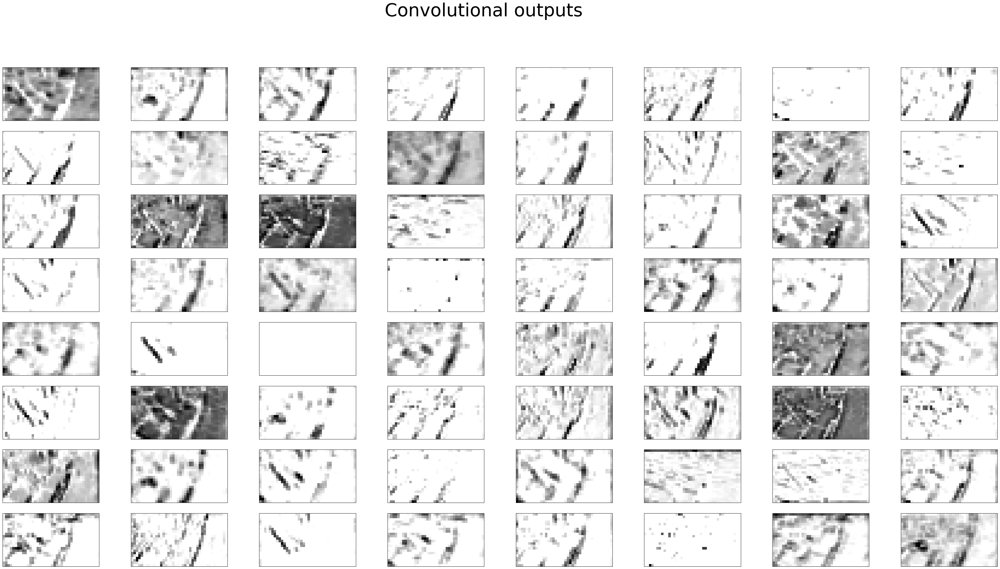

In [157]:
plot_outputs(test_image, vgg19_model.layers[1], vgg19_model.layers[11], rows=8, cols=8)

The regions are even more clearly outlined. Here's the test image again for reference.

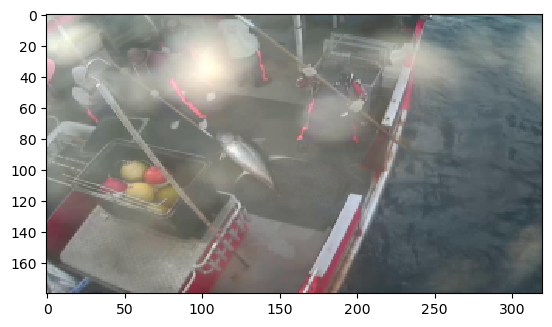

In [158]:
plot_single(test_image)

In [168]:
aug_batch_size = 64
aug_num_epochs = 15
aug_num_steps_per_epoch = 25

In [169]:
transfer_hist1 = transfer_model.fit(idg.flow(fish_train_features_bal, fish_train_labels_bal_ohc, 
                                                          batch_size=aug_batch_size),
                        epochs=aug_num_epochs,
                        validation_data=[fish_val_features, fish_val_labels_ohc],
                        steps_per_epoch=aug_num_steps_per_epoch,
                        callbacks=[transfer_reduction, transfer_stopper, transfer_checkpointer])

Epoch 1/15
25/25 [==============================] - ETA: 0s - loss: 0.9603 - accuracy: 0.6544 
Epoch 1: val_accuracy did not improve from 0.53968
25/25 [==============================] - 1076s 43s/step - loss: 0.9603 - accuracy: 0.6544 - val_loss: 1.2243 - val_accuracy: 0.5370 - lr: 1.0000e-07
Epoch 2/15
25/25 [==============================] - ETA: 0s - loss: 0.9350 - accuracy: 0.6662 
Epoch 2: val_accuracy did not improve from 0.53968
25/25 [==============================] - 1129s 45s/step - loss: 0.9350 - accuracy: 0.6662 - val_loss: 1.2270 - val_accuracy: 0.5370 - lr: 1.0000e-07
Epoch 3/15
25/25 [==============================] - ETA: 0s - loss: 0.9630 - accuracy: 0.6675 
Epoch 3: val_accuracy did not improve from 0.53968
25/25 [==============================] - 1086s 43s/step - loss: 0.9630 - accuracy: 0.6675 - val_loss: 1.2278 - val_accuracy: 0.5291 - lr: 1.0000e-07
Epoch 4/15
25/25 [==============================] - ETA: 0s - loss: 0.9692 - accuracy: 0.6500 
Epoch 4: val_accurac

In [ ]:
joblib.dump(transfer_hist1.history, 'transfer_hist1.jbl')
transfer_hist_loaded = joblib.load('transfer_hist1.jbl')
transfer_model.load_weights('best_model_transfer1.h5')

In [ ]:
eval_model(transfer_hist_loaded, transfer_model, test_features=fish_test_features, test_labels=fish_test_labels_ohc,
          val_features=fish_val_features, val_labels=fish_val_labels_ohc, top_lim=None, loaded=True)